# Imports

In [722]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import json
from sklearn.compose import make_column_selector as selector
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
import lime.lime_tabular
import shap
from interpret.glassbox import ExplainableBoostingClassifier
from interpret import show
from sklearn.model_selection import train_test_split, StratifiedShuffleSplit
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from SyntheticDataset import SyntheticDataset
from DatasetAnalysis import DatasetAnalysis
from PerformanceAnalysis import PerformanceAnalysis
from Visualization import Visualization

# Setup

In [723]:
config_file = open('config.json')
config_vars = json.load(config_file)
config_file.close()

logs_dir = config_vars["logs_dir"] + "/synthBin_tests"

In [790]:
config_file = open('visual_config.json')
config_vars = json.load(config_file)
config_file.close()

shap_colors_neg = config_vars["shap_colors"]["negative"]
shap_colors_pos = config_vars["shap_colors"]["positive"]
shap_colors = np.array([tuple(shap_colors_neg), tuple(shap_colors_pos)])

title_size = config_vars["title_font_size"]
label_size = config_vars["labels_font_size"]

green_color = tuple([x/255 for x in config_vars["green_colors"]["c2"]])

# Get Dataset

In [725]:
perf_analysis = PerformanceAnalysis()

min_val = -100
max_val = 100
num_rows = 1000
num_features = 10
num_classes = 2
# rand_coef = [[0.9, 0.9],
#              [0.8, 0.8],
#              [0.7, 0.7],
#              [0.6, 0.6],
#              [0.5, 0.5],
#              [0.4, 0.4],
#              [0.3, 0.3],
#              [0.2, 0.2],
#              [0.1, 0.1],
#              [0.05, 0.05]]


#std_dev = np.array([1, 0.95, 0.9, 0.85, 0.8, 0.75, 0.7, 0.65, 0.6, 0.55])
std_dev = np.array([1.5 - (0.1 * i) for i in range(num_features)])
class_sep = np.ones(10) * 0.5
    
    #np.array([0.55, 0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95, 0.65])

# rand_coef = [[0.95 - 1 / (num_features * 2) * x, 0.95 - 1 / (num_features * 2) * x] for x in range(num_features)]
features_names = ["Var" + (str(x)) for x in range(num_features)]
# dataset = SyntheticDataset(min_val, max_val, num_rows, num_features, num_classes, rand_coef, seed=42)
dataset = SyntheticDataset(min_val, max_val, num_rows, num_features, num_classes, norm_dist=True, std_dev_perc=std_dev, class_sep_perc=class_sep)
dataset.generate()
dataset.get_data()

array([[-70.49132831,   8.74155591, -13.30134665, ..., -15.28589273,
        -20.64146454,   0.        ],
       [-46.6694256 ,  16.32266363,   8.09185641, ..., -32.66531724,
        -15.92012213,   0.        ],
       [-33.48739991,   0.6866287 ,  12.29383189, ..., -23.02347645,
         -6.02622294,   0.        ],
       ...,
       [-34.10583542, -10.47539281,  40.82013452, ...,  31.34146018,
         26.87522741,   1.        ],
       [ 19.55474721,  35.66124755,  27.37631061, ...,  24.07589348,
         -0.6763058 ,   1.        ],
       [-44.90179478,   8.98130686, -15.77217866, ...,  40.97291426,
         29.2086163 ,   1.        ]])

In [793]:
print([x for x in class_sep])

[0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5]


In [727]:
X = pd.DataFrame(dataset.get_x(), columns=features_names)
y = dataset.get_y()

In [728]:
rand_coef

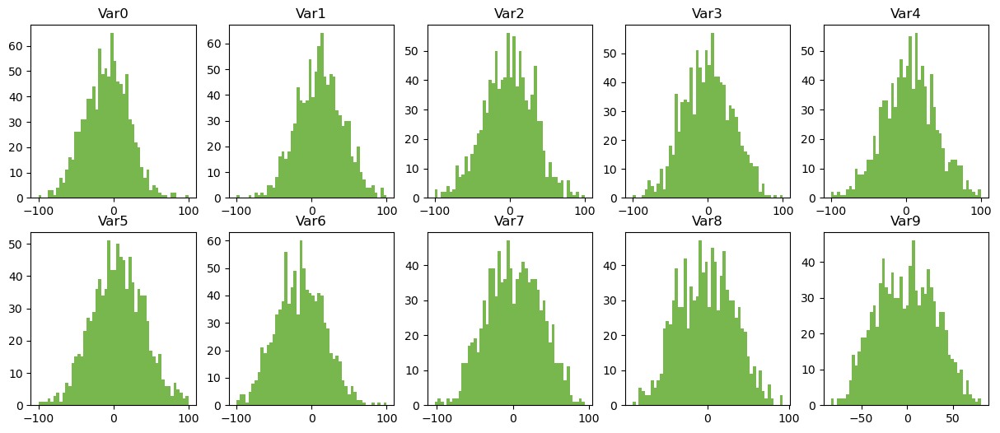

In [796]:
# fig, ax = plt.subplots(2, 5, figsize=(15, 6))
# ax = ax.flatten()
# 
# cont = 0
# for x in ax:
#     
#     x.hist(X.iloc[:, cont], bins=50, color=green_color)
#     x.set_title(f"Var{cont}")
#     cont += 1
# 
# plt.show()

###### Obtain Dataset From Repository

The only categorical column is 'ID' which has no relevance for classification because is just an identifier of each experiment, so it will be dropped

In [730]:
sss_nsplits = 10
sss = StratifiedShuffleSplit(n_splits=sss_nsplits, test_size=0.2)


lr_clfs = []
lr_limes = []
lr_shaps = []
rf_clfs = []
rf_limes = []
rf_shaps = []
svm_clfs = []
svm_limes = []
svm_shaps = []
ebm_clfs = []

In [731]:
X_trains_pd = []
X_tests_pd = []
Y_trains = []
Y_tests = []
for i, (train_index, test_index) in enumerate(sss.split(X, y)):
    print(len(train_index), len(test_index))
    print(train_index, test_index)
    X_trains_pd.append(X.iloc[train_index])
    X_tests_pd.append(X.iloc[test_index])
    Y_trains.append(y[train_index])
    Y_tests.append(y[test_index])

# X_train = X_train_pd.to_numpy()
# X_test = X_test_pd.to_numpy()

800 200
[ 26 328 423  79 310 277 657 718  93 245 546 340 206 932 445 532 982 236
 855 415 573 571 263 440   9 547 691 758 944 804 987 783 776 211 237 107
 933 190 778 402 561 446 465 937 268 334 866 903 312 717 358 946  11 131
 155 907 879 556 287 172 433 654 744 652 230 478 672 122 455 862  52 579
 473 812 568  46 816 599 203  44 565 766 523 849 253 285 530 193 444 179
 934 320 976  65 208 276 583  41  83 680 600 289 707 796 315 619 348 664
 597 484 888 214 666 331 104 210 727 353 102 803 272 222 558 651 451 543
 362  35 205 213 136 517 368 428 166   4  67 119 801 833 710 882 397 835
  84 275 823  33 456 904 431 557 603 223 462 100 394 412 387  32 994 332
 297 858 860  86 572 308 820 140 164 349 775 760 649 232 432 789  76 735
 469  94  69 980 924 243 142 645 489 257 906  16 702 605 998 927 384 961
 625 336 458 301 684 407 231 522 309 367 238 553  96 751 640 740 536 560
 647  42 467 508 124 749 196 772 541 807 838 955  63 606 209 360 487  78
 857 224 992  17 867 323 851 683 373 569 59

## Instance to extract local explanations for all models

In [732]:
Exp_index = 3
# Exp_inst = X_test[Exp_index, :]
# Exp_inst_pd = X_test_pd.iloc[Exp_index, :]
# Exp_inst_class = Y_test[Exp_index]
# print(f"Instance:\n{Exp_inst_pd}\n\nClass: {Exp_inst_class}") #"Name" and "dtype" are not part of the instance, they must be ignored

# Classification

In [733]:
perf_analysis = PerformanceAnalysis()

## <i>Logistic Regression</i> (LR)

In [734]:
for i in range(sss_nsplits):
    lr_clf = LogisticRegression(solver="liblinear", max_iter=100, C=0.1, random_state=42).fit(X_trains_pd[i].to_numpy(), Y_trains[i])
    lr_clfs.append(lr_clf)

### Extract Explanations

#### Local

##### <i>Local Model-Agnostic Explanations</i> (LIME)

In [735]:
for i in range(sss_nsplits):
    lr_LIME_explainer = lime.lime_tabular.LimeTabularExplainer(X_trains_pd[i].to_numpy(), feature_names=features_names)
    lr_limes.append(lr_LIME_explainer)
#lr_LIME_explanation = lr_LIME_explainer.explain_instance(Exp_inst, lr_clf.predict_proba)

In [736]:
#lr_LIME_explanation.show_in_notebook(show_table=True)

##### <i>SHapley Additive exPlanations</i> (SHAP)

In [737]:
shap.initjs()

In [738]:
for i in range(sss_nsplits):
    lr_SHAP_exp = shap.KernelExplainer(lr_clfs[i].predict_proba, shap.sample(X_trains_pd[i], 20))
    lr_shaps.append(lr_SHAP_exp)
#lr_shap_loc_values = np.array(lr_SHAP_exp.shap_values(Exp_inst_pd))

In [739]:
#shap.force_plot(lr_SHAP_exp.expected_value[1], lr_shap_loc_values[1, :], Exp_inst_pd)

#### Global (SHAP)

In [740]:
#lr_shap_global_values = lr_SHAP_exp.shap_values(X_test_pd)

In [741]:
#shap.summary_plot(lr_shap_global_values, X_test_pd, plot_type="bar")

## <i>Random Forest</i> (RF)

In [742]:
for i in range(sss_nsplits):
    rf_clf = RandomForestClassifier(n_estimators=1000, bootstrap=False, max_features="sqrt", random_state=42).fit(X_trains_pd[i].to_numpy(), Y_trains[i])
    rf_clfs.append(rf_clf)

In [743]:
# rf_ye = rf_clf.predict(X_test)
# 
# rf_cm = confusion_matrix(Y_test, rf_ye)
# rf_metrics = perf_analysis.compute_metrics(rf_cm)
# display(rf_metrics)
# 
# ConfusionMatrixDisplay.from_predictions(Y_test, rf_ye)
# 
# rf_y2d = rf_clf.predict_proba(X_test)[:, 1]
# 
# plt.show()

### Extract Explanations 

#### Local

##### <i>Local Model-Agnostic Explanations</i> (LIME)

In [744]:
for i in range(sss_nsplits):
    rf_LIME_explainer = lime.lime_tabular.LimeTabularExplainer(X_trains_pd[i].to_numpy(), feature_names=features_names)
    rf_limes.append(rf_LIME_explainer)
#rf_LIME_explanation = rf_LIME_explainer.explain_instance(Exp_inst, rf_clf.predict_proba)

In [745]:
#rf_LIME_explanation.show_in_notebook(show_table=True)

##### <i>SHapley Additive exPlanations</i> (SHAP)

In [746]:
for i in range(sss_nsplits):
    rf_SHAP_exp = shap.Explainer(rf_clfs[i])
    rf_shaps.append(rf_SHAP_exp)
#rf_shap_loc_values = np.array(rf_SHAP_exp.shap_values(Exp_inst_pd))

In [747]:
#shap.force_plot(rf_SHAP_exp.expected_value[1], rf_shap_loc_values[1, :], Exp_inst_pd)

#### Global (SHAP)

In [748]:
#rf_shap_global_values = rf_SHAP_exp.shap_values(X_test_pd)

In [749]:
#shap.summary_plot(rf_shap_global_values, X_test_pd, plot_type="bar")

## <i> Support Vector Machines</i> (SVM)

In [750]:
for i in range(sss_nsplits):
    svm_clf = SVC(kernel="rbf", C=0.1, cache_size=1000, probability=True, random_state=42).fit(X_trains_pd[i].to_numpy(), Y_trains[i])
    svm_clfs.append(svm_clf)

In [751]:
# svm_ye = svm_clf.predict(X_test)
# 
# svm_cm = confusion_matrix(Y_test, svm_ye)
# svm_metrics = perf_analysis.compute_metrics(svm_cm)
# display(svm_metrics)
# 
# ConfusionMatrixDisplay.from_predictions(Y_test, svm_ye)
# 
# svm_y2d = svm_clf.decision_function(X_test)
# 
# plt.show()

### Extract Explanations

#### Local

##### <i>Local Model-Agnostic Explanations</i> (LIME)

In [752]:
# svm_LIME_explainer = lime.lime_tabular.LimeTabularExplainer(X_train, feature_names=features_names)
# svm_LIME_explanation = svm_LIME_explainer.explain_instance(Exp_inst, svm_clf.predict_proba)

In [753]:
for i in range(sss_nsplits):
    svm_LIME_explainer = lime.lime_tabular.LimeTabularExplainer(X_trains_pd[i].to_numpy(), feature_names=features_names)
    svm_limes.append(svm_LIME_explainer)

In [754]:
#svm_LIME_explanation.show_in_notebook(show_table=True)

##### <i>SHapley Additive exPlanations</i> (SHAP)

In [755]:
for i in range(sss_nsplits):
    svm_SHAP_exp = shap.KernelExplainer(svm_clfs[i].predict_proba, shap.sample(X_trains_pd[i], 20))
    svm_shaps.append(svm_SHAP_exp)
#svm_shap_loc_values = np.array(svm_SHAP_exp.shap_values(Exp_inst_pd))

In [756]:
#shap.force_plot(svm_SHAP_exp.expected_value[1], svm_shap_loc_values[1, :], Exp_inst_pd)

#### Global (SHAP)

In [757]:
#svm_shap_global_values = svm_SHAP_exp.shap_values(X_test_pd)

In [758]:
#shap.summary_plot(svm_shap_global_values, X_test_pd, plot_type="bar")

## <i>Explainable Boosting Machine</i> (EBM)

In [759]:
for i in range(sss_nsplits):
    print(i)
    ebm_clf = ExplainableBoostingClassifier(max_bins=1024, smoothing_rounds=1000, cyclic_progress=0, random_state=42).fit(X_trains_pd[i], Y_trains[i])
    ebm_clfs.append(ebm_clf)

0
1
2
3
4
5
6
7
8
9


In [760]:
# ebm_ye = ebm_clf.predict(X_test_pd)
# 
# ebm_cm = confusion_matrix(Y_test, ebm_ye)
# ebm_metrics = perf_analysis.compute_metrics(ebm_cm)
# display(ebm_metrics)
# 
# ConfusionMatrixDisplay.from_predictions(Y_test, ebm_ye)
# 
# ebm_y2d = ebm_clf.decision_function(X_test)
# 
# plt.show()

### Extract Explanations

#### Local

In [761]:
# ebm_local = ebm_clf.explain_local(X_test, Y_test)
# show(ebm_local)

#### Global

In [762]:
# ebm_global = ebm_clf.explain_global()
# show(ebm_global)

# Summary

In [763]:
visual = Visualization()

## Metrics

In [764]:
lr_cms = []
rf_cms = []
svm_cms = []
ebm_cms = []

lr_metrics_lst = []
rf_metrics_lst = []
svm_metrics_lst = []
ebm_metrics_lst = []

for i in range(sss_nsplits):
    lr_ye = lr_clfs[i].predict(X_tests_pd[i].to_numpy())
    lr_cm = confusion_matrix(Y_tests[i], lr_ye)
    
    lr_metrics = perf_analysis.compute_metrics(lr_cm)
    lr_metrics = lr_metrics.rename(columns={"Values": "LR"})
    lr_metrics["LR"] = [round(x, 2) for x in lr_metrics["LR"]]
    lr_metrics_lst.append(lr_metrics)
    lr_cms.append(lr_cm)
    
    rf_ye = rf_clfs[i].predict(X_tests_pd[i].to_numpy())
    rf_cm = confusion_matrix(Y_tests[i], rf_ye)
    rf_metrics = perf_analysis.compute_metrics(rf_cm)
    rf_metrics = rf_metrics.rename(columns={"Values": "RF"})
    rf_metrics["RF"] = [round(x, 2) for x in rf_metrics["RF"]]
    rf_metrics_lst.append(rf_metrics)
    rf_cms.append(rf_cm)

    svm_ye = svm_clfs[i].predict(X_tests_pd[i].to_numpy())
    svm_cm = confusion_matrix(Y_tests[i], svm_ye)
    svm_metrics = perf_analysis.compute_metrics(svm_cm)
    svm_metrics = svm_metrics.rename(columns={"Values": "SVM"})
    svm_metrics["SVM"] = [round(x, 2) for x in svm_metrics["SVM"]]
    svm_metrics_lst.append(svm_metrics)
    svm_cms.append(svm_cm)

    ebm_ye = ebm_clfs[i].predict(X_tests_pd[i].to_numpy())
    ebm_cm = confusion_matrix(Y_tests[i], ebm_ye)
    ebm_metrics = perf_analysis.compute_metrics(ebm_cm)
    ebm_metrics = ebm_metrics.rename(columns={"Values": "EBM"})
    ebm_metrics["EBM"] = [round(x, 2) for x in ebm_metrics["EBM"]]
    ebm_metrics_lst.append(ebm_metrics)
    ebm_cms.append(ebm_cm)

    overall_metrics = pd.concat([lr_metrics, rf_metrics, svm_metrics, ebm_metrics], axis=1)
    display(overall_metrics)

Metrics,LR,RF,SVM,EBM
accuracy,0.99,0.99,0.99,0.99
false-positive rate,0.02,0.02,0.02,0.02
false-negative rate,0.00,0.00,0.00,0.00
precision,0.98,0.98,0.98,0.98
recall,1.00,1.00,1.00,1.00
f-score,0.99,0.99,0.99,0.99


Metrics,LR,RF,SVM,EBM
accuracy,0.98,0.98,0.99,0.98
false-positive rate,0.01,0.01,0.01,0.01
false-negative rate,0.02,0.02,0.00,0.02
precision,0.99,0.99,0.99,0.99
recall,0.98,0.98,1.00,0.98
f-score,0.98,0.98,1.00,0.98


Metrics,LR,RF,SVM,EBM
accuracy,0.99,0.98,0.98,0.98
false-positive rate,0.02,0.04,0.03,0.03
false-negative rate,0.00,0.00,0.00,0.01
precision,0.98,0.96,0.97,0.97
recall,1.00,1.00,1.00,0.99
f-score,0.99,0.98,0.99,0.98


Metrics,LR,RF,SVM,EBM
accuracy,0.99,1.0,0.99,0.99
false-positive rate,0.02,0.0,0.02,0.01
false-negative rate,0.00,0.0,0.00,0.00
precision,0.98,1.0,0.98,0.99
recall,1.00,1.0,1.00,1.00
f-score,0.99,1.0,0.99,1.00


Metrics,LR,RF,SVM,EBM
accuracy,0.98,0.96,0.98,0.98
false-positive rate,0.02,0.04,0.03,0.04
false-negative rate,0.01,0.03,0.01,0.00
precision,0.98,0.96,0.97,0.96
recall,0.99,0.97,0.99,1.00
f-score,0.99,0.97,0.98,0.98


Metrics,LR,RF,SVM,EBM
accuracy,0.98,0.98,0.99,0.99
false-positive rate,0.01,0.02,0.01,0.01
false-negative rate,0.02,0.01,0.01,0.01
precision,0.99,0.98,0.99,0.99
recall,0.98,0.99,0.99,0.99
f-score,0.98,0.99,0.99,0.99


Metrics,LR,RF,SVM,EBM
accuracy,1.0,0.98,1.0,1.0
false-positive rate,0.0,0.02,0.0,0.0
false-negative rate,0.0,0.02,0.0,0.0
precision,1.0,0.98,1.0,1.0
recall,1.0,0.98,1.0,1.0
f-score,1.0,0.98,1.0,1.0


Metrics,LR,RF,SVM,EBM
accuracy,0.98,0.98,0.98,0.98
false-positive rate,0.02,0.03,0.03,0.03
false-negative rate,0.01,0.01,0.00,0.01
precision,0.98,0.97,0.97,0.97
recall,0.99,0.99,1.00,0.99
f-score,0.99,0.98,0.99,0.98


Metrics,LR,RF,SVM,EBM
accuracy,0.99,0.99,0.99,0.99
false-positive rate,0.02,0.02,0.02,0.02
false-negative rate,0.00,0.00,0.00,0.00
precision,0.98,0.98,0.98,0.98
recall,1.00,1.00,1.00,1.00
f-score,0.99,0.99,0.99,0.99


Metrics,LR,RF,SVM,EBM
accuracy,0.98,0.98,0.98,0.98
false-positive rate,0.02,0.03,0.03,0.03
false-negative rate,0.01,0.01,0.01,0.01
precision,0.98,0.97,0.97,0.97
recall,0.99,0.99,0.99,0.99
f-score,0.99,0.98,0.98,0.98


In [765]:
lr_metrics_concat = pd.concat(tuple(lr_metrics_lst[:]), axis=1)
lr_means = lr_metrics_concat.mean(axis=1).to_frame()
lr_means = lr_means.rename(columns={0: "LR"})
lr_means["LR"] = [round(x, 2) for x in lr_means["LR"]]

In [766]:
lr_std = lr_metrics_concat.std(axis=1).to_frame()
lr_std = lr_std.rename(columns={0: "LR"})
lr_std["LR"] = [round(x, 2) for x in lr_std["LR"]]

In [767]:
rf_metrics_concat = pd.concat(tuple(rf_metrics_lst[:]), axis=1)
rf_means = rf_metrics_concat.mean(axis=1).to_frame()
rf_means = rf_means.rename(columns={0: "RF"})
rf_means["RF"] = [round(x, 2) for x in rf_means["RF"]]

In [768]:
rf_std = rf_metrics_concat.std(axis=1).to_frame()
rf_std = rf_std.rename(columns={0: "RF"})
rf_std["RF"] = [round(x, 2) for x in rf_std["RF"]]

In [769]:
svm_metrics_concat = pd.concat(tuple(svm_metrics_lst[:]), axis=1)
svm_means = svm_metrics_concat.mean(axis=1).to_frame()
svm_means = svm_means.rename(columns={0: "SVM"})
svm_means["SVM"] = [round(x, 2) for x in svm_means["SVM"]]

In [770]:
svm_std = svm_metrics_concat.std(axis=1).to_frame()
svm_std = svm_std.rename(columns={0: "SVM"})
svm_std["SVM"] = [round(x, 2) for x in svm_std["SVM"]]

In [771]:
ebm_metrics_concat = pd.concat(tuple(ebm_metrics_lst[:]), axis=1)
ebm_means = ebm_metrics_concat.mean(axis=1).to_frame()
ebm_means = ebm_means.rename(columns={0: "EBM"})
ebm_means["EBM"] = [round(x, 2) for x in ebm_means["EBM"]]

In [772]:
ebm_std = ebm_metrics_concat.std(axis=1).to_frame()
ebm_std = ebm_std.rename(columns={0: "EBM"})
ebm_std["EBM"] = [round(x, 2) for x in ebm_std["EBM"]]

In [773]:
overall_metrics_means = pd.concat([lr_means, rf_means, svm_means, ebm_means], axis=1)
display(overall_metrics_means)

,LR,RF,SVM,EBM
accuracy,0.99,0.98,0.99,0.99
false-positive rate,0.02,0.02,0.02,0.02
false-negative rate,0.01,0.01,0.00,0.01
precision,0.98,0.98,0.98,0.98
recall,0.99,0.99,1.00,0.99
f-score,0.99,0.98,0.99,0.99


In [774]:
overall_metrics_std = pd.concat([lr_std, rf_std, svm_std, ebm_std], axis=1)
display(overall_metrics_std)

,LR,RF,SVM,EBM
accuracy,0.01,0.01,0.01,0.01
false-positive rate,0.01,0.01,0.01,0.01
false-negative rate,0.01,0.01,0.00,0.01
precision,0.01,0.01,0.01,0.01
recall,0.01,0.01,0.00,0.01
f-score,0.01,0.01,0.01,0.01


In [775]:
latex_str = "Metrics"  + ''.join([" & " + x for x in overall_metrics_means.columns]) + " \\\ \n"

In [776]:
for i, row in overall_metrics_means.iterrows():
    
    aux_str = i
    for k in row:
        aux_str += f" & {k}"
    
    latex_str += aux_str + " \\\ \n"

with open(f"{logs_dir}/synth_bin_test_metrics_means.txt", "w") as text_file:
    print(latex_str, file=text_file)

In [777]:
latex_str = "Metrics"  + ''.join([" & " + x for x in overall_metrics_std.columns]) + " \\\ \n"

In [778]:
for i, row in overall_metrics_std.iterrows():
    
    aux_str = i
    for k in row:
        aux_str += f" & {k}"
    
    latex_str += aux_str + " \\\ \n"

with open(f"{logs_dir}/synth_bin_test_metrics_std.txt", "w") as text_file:
    print(latex_str, file=text_file)

In [779]:
latex_str = "Metrics"  + ''.join([" & " + x for x in overall_metrics_means.columns]) + " \\\ \n"

In [780]:
for i, row in overall_metrics_means.iterrows():
    
    aux_str = i
    
    cont = 0
    for k in row:
        aux_str += f" & {k} \\textpm{overall_metrics_std.loc[[i]].iloc[0].iloc[cont]}"
        cont += 1
    
    latex_str += aux_str + " \\\ \n"

with open(f"{logs_dir}/synth_bin_test_metrics_means_wstd.txt", "w") as text_file:
    print(latex_str, file=text_file)

## Confusion Matrices

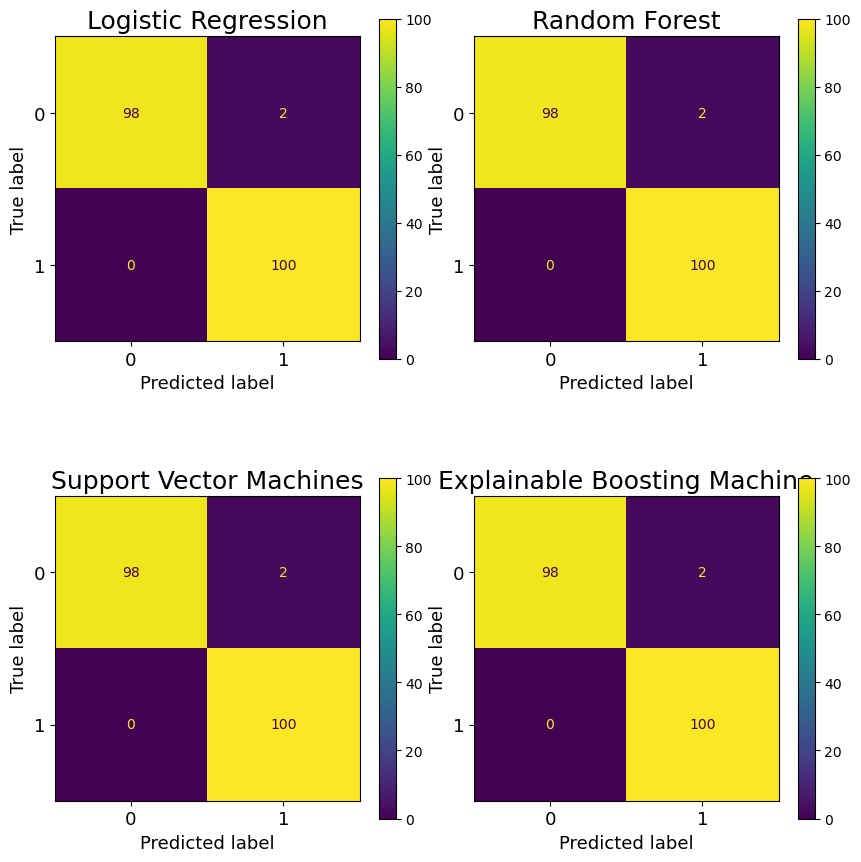

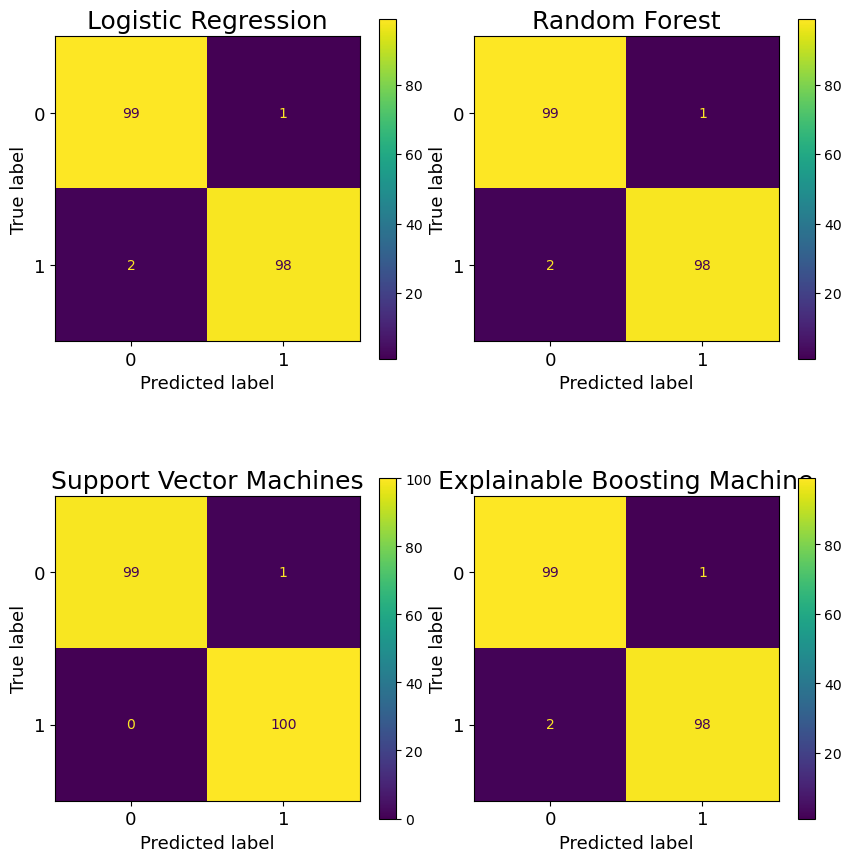

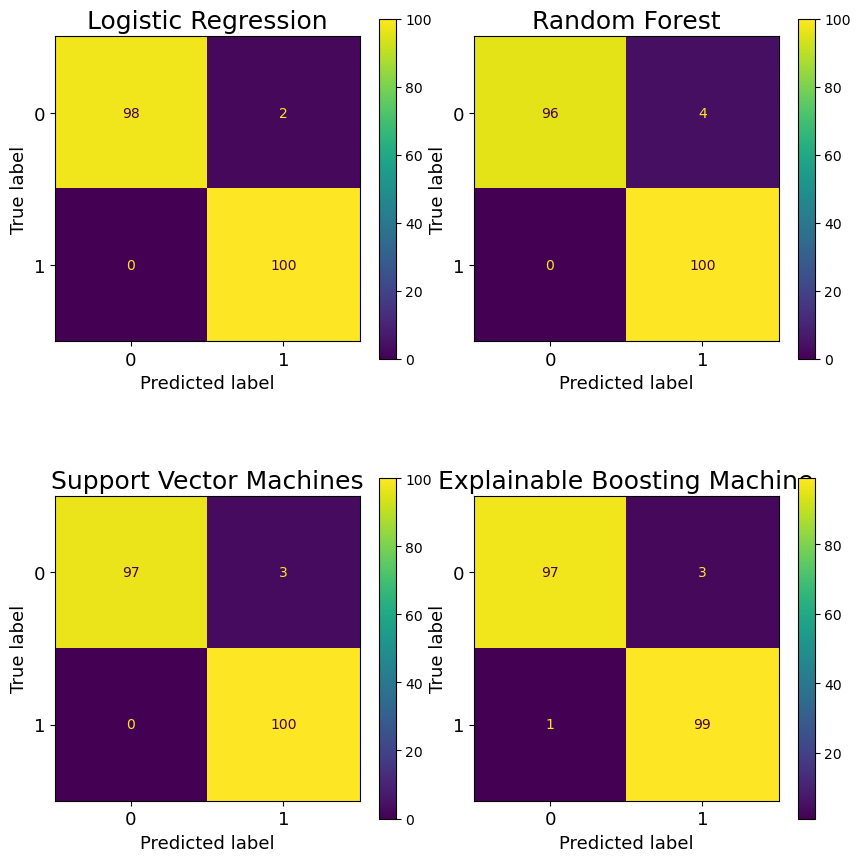

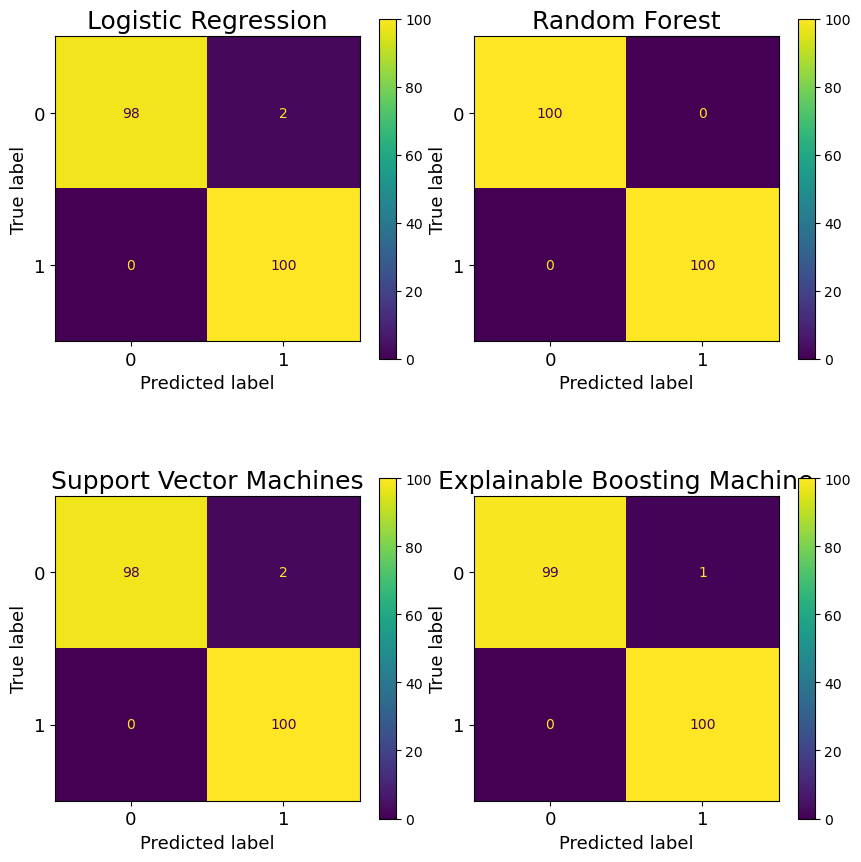

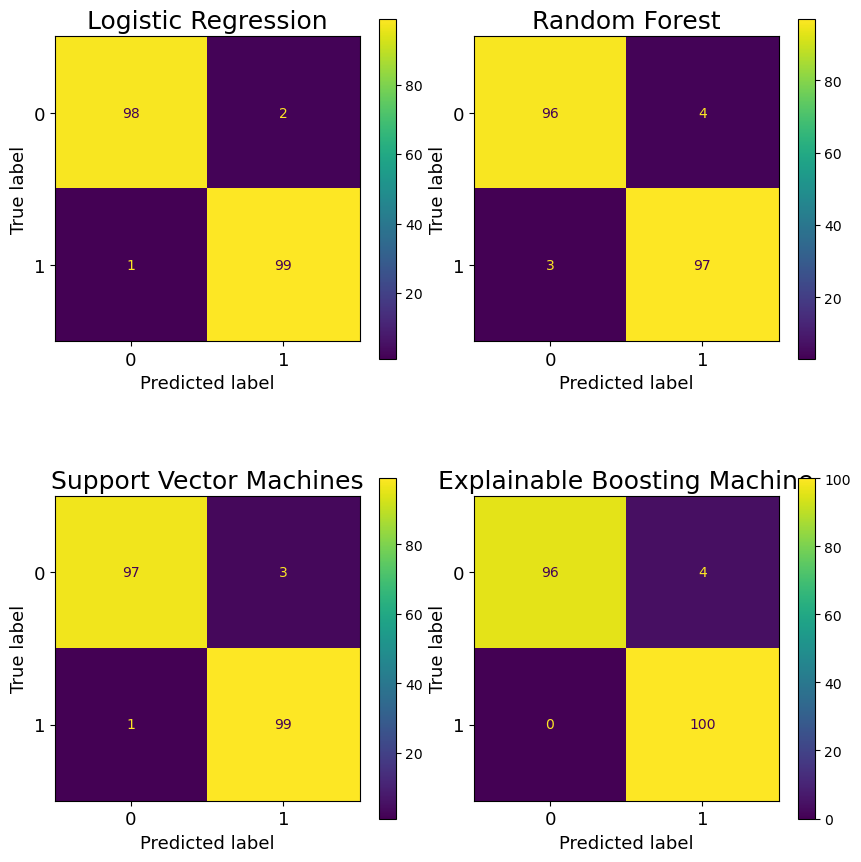

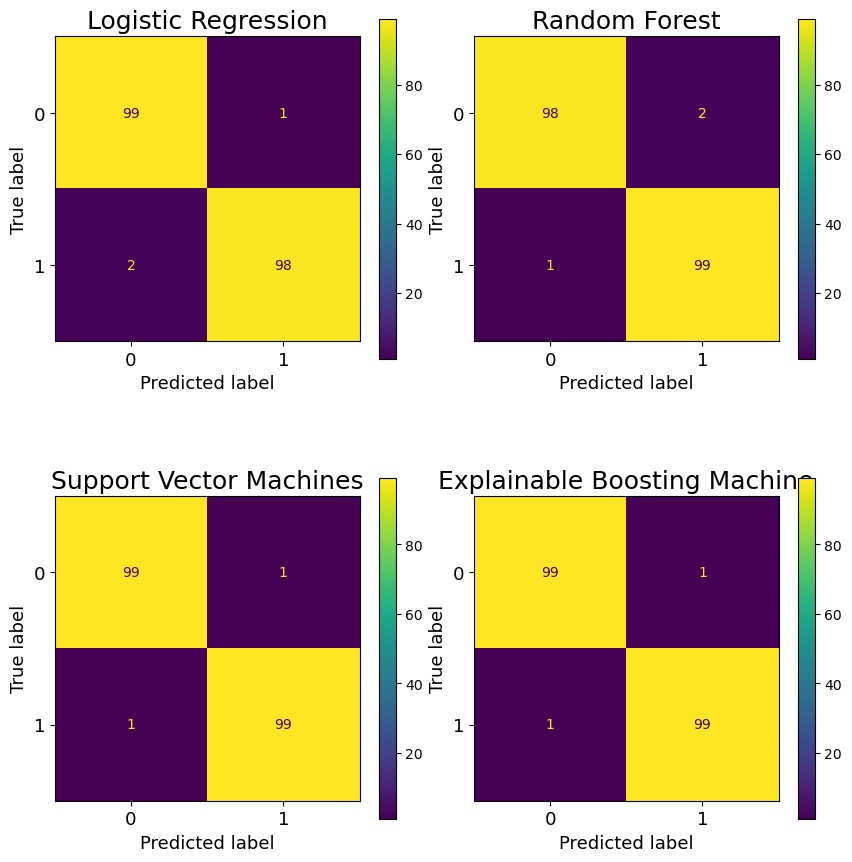

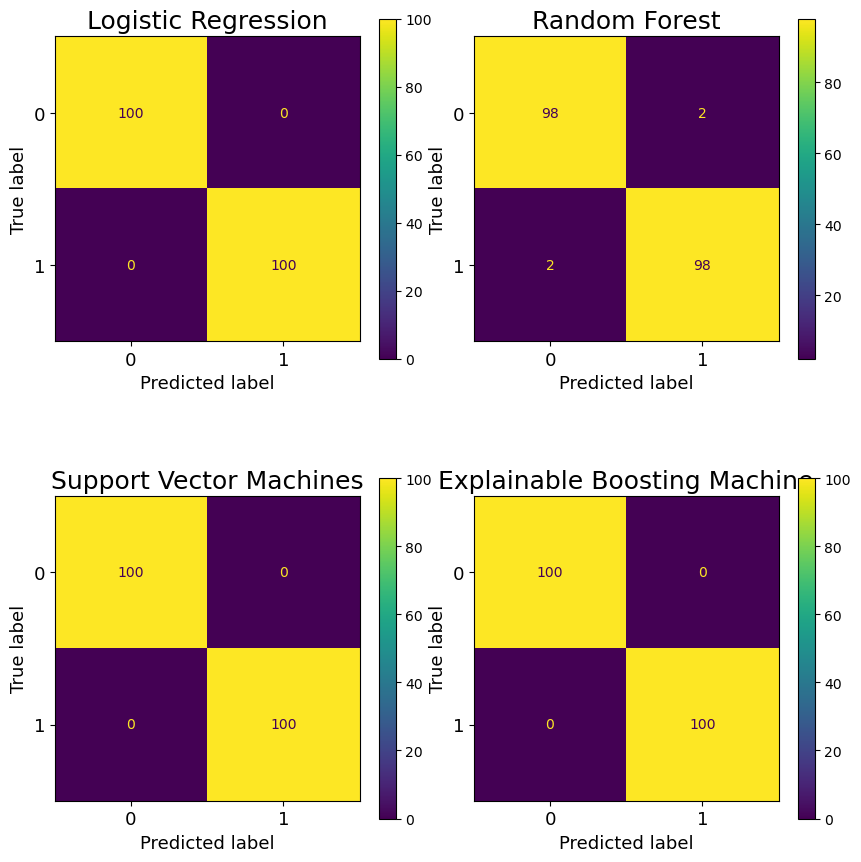

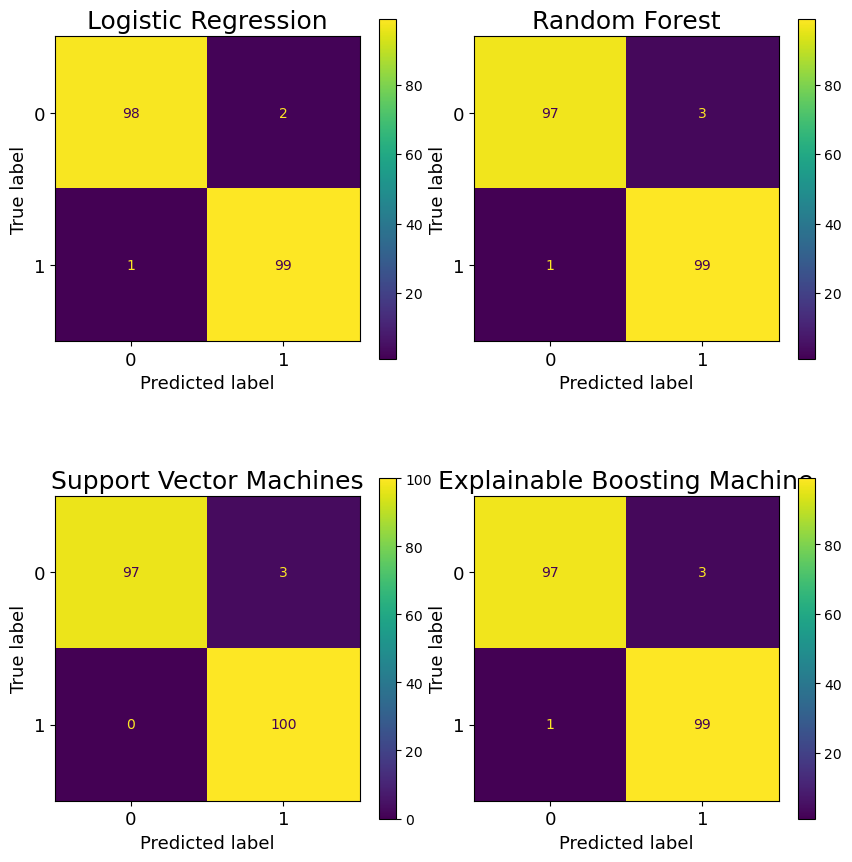

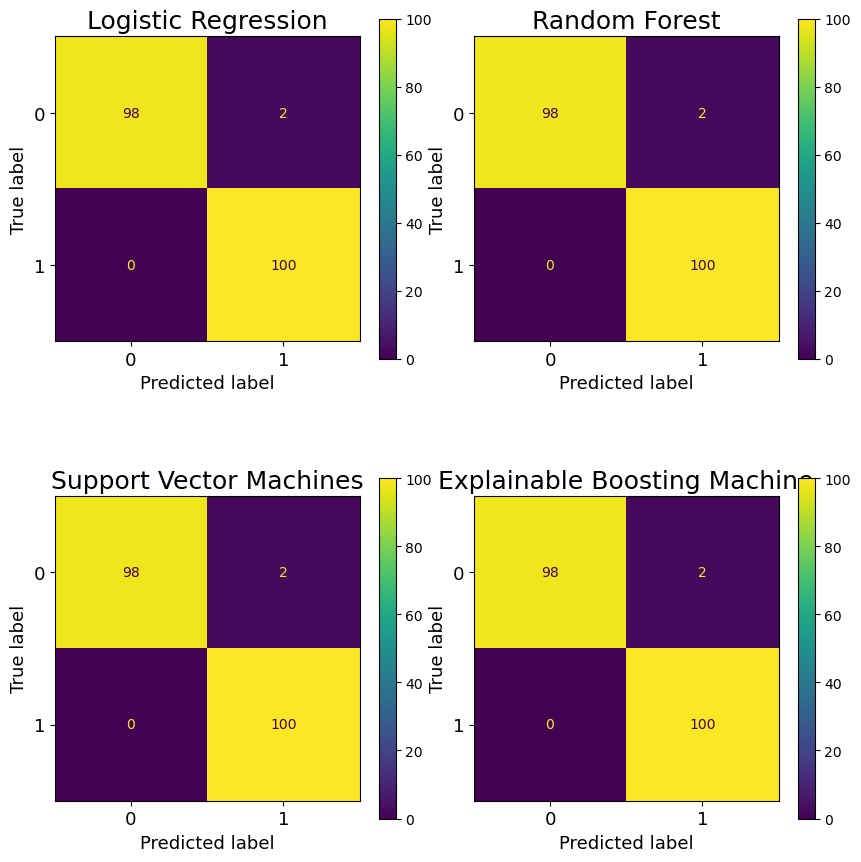

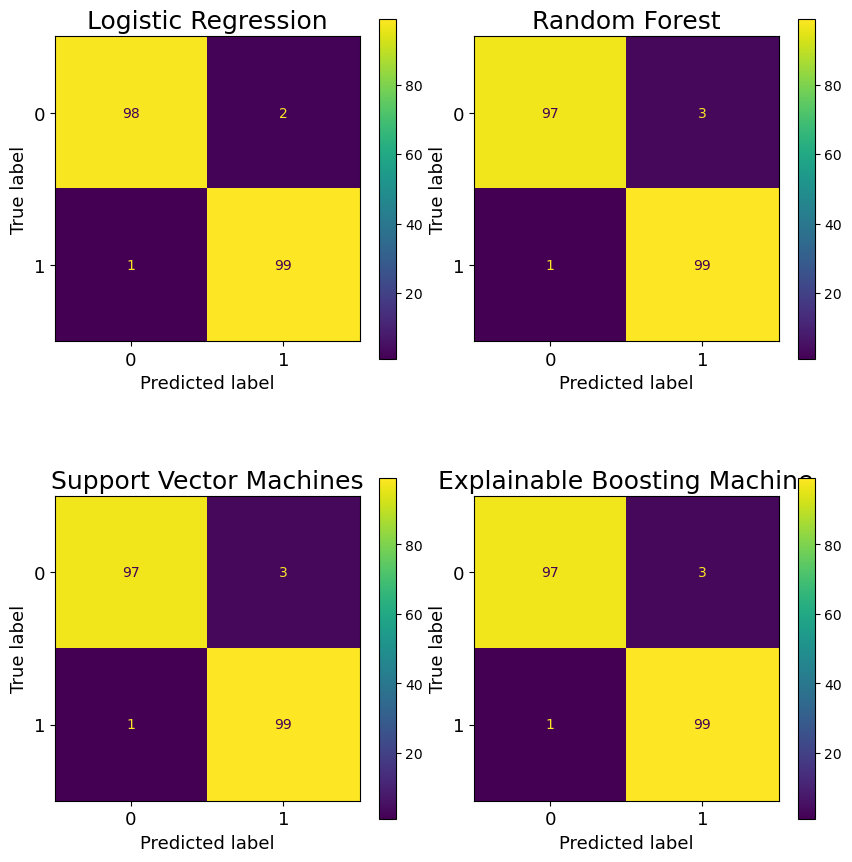

In [781]:
for i in range(sss_nsplits):
    lr_ye = lr_clfs[i].predict(X_tests_pd[i].to_numpy())
    rf_ye = rf_clfs[i].predict(X_tests_pd[i].to_numpy())
    svm_ye = svm_clfs[i].predict(X_tests_pd[i].to_numpy())
    ebm_ye = ebm_clfs[i].predict(X_tests_pd[i].to_numpy())
    visual.confusion_matrices_pred([Y_tests[i], Y_tests[i], Y_tests[i], Y_tests[i]], 
                              [lr_ye, rf_ye, svm_ye, ebm_ye],
                              nrows=2, 
                              ncols=2, 
                              figsize=(8, 8),
                              title_size=title_size,
                              label_size=label_size,
                              titles=["Logistic Regression", "Random Forest", "Support Vector Machines", "Explainable Boosting Machine"]
                              )
    
    plt.savefig(f"{logs_dir}/synth_bin_test_conf_matrices_{i}.png", bbox_inches="tight")
    
    plt.show()

## Curves

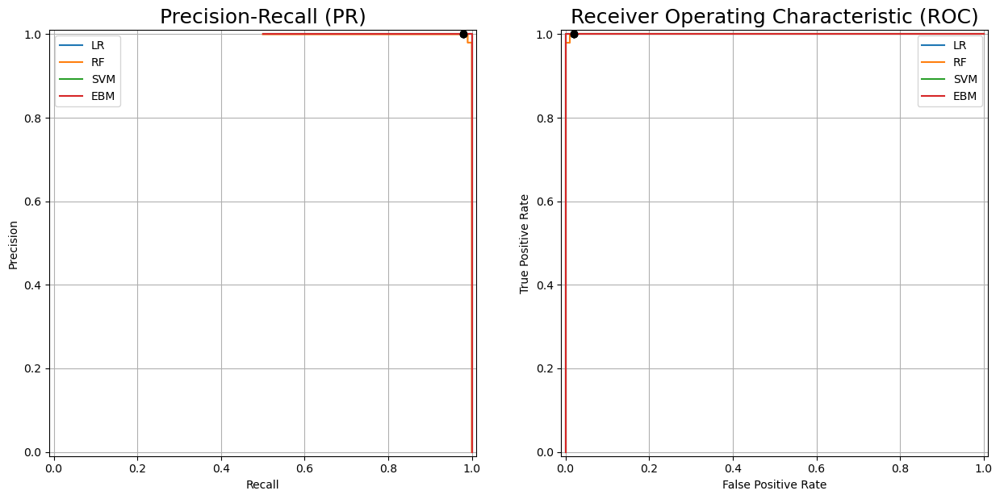

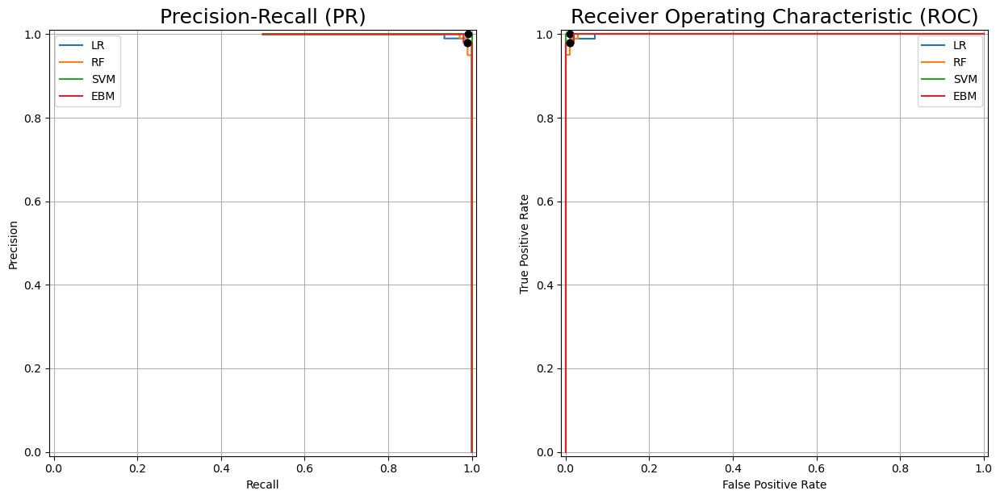

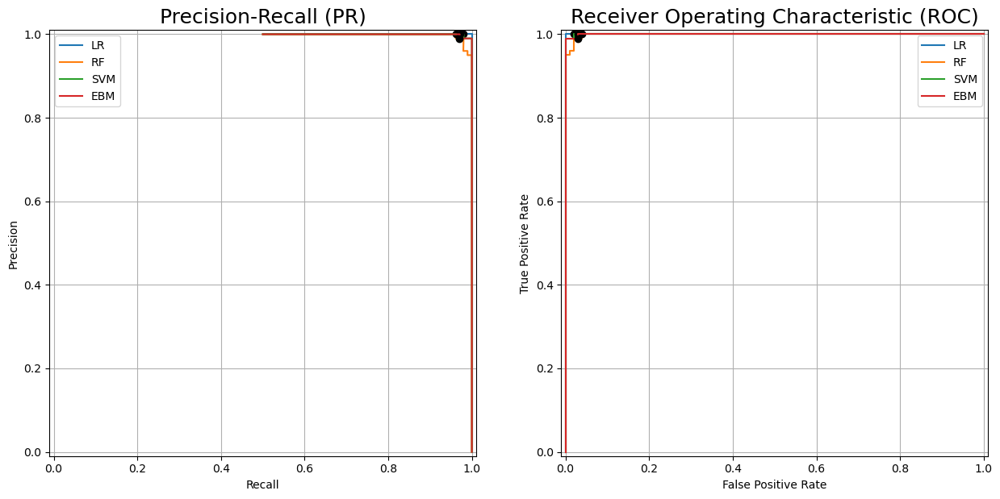

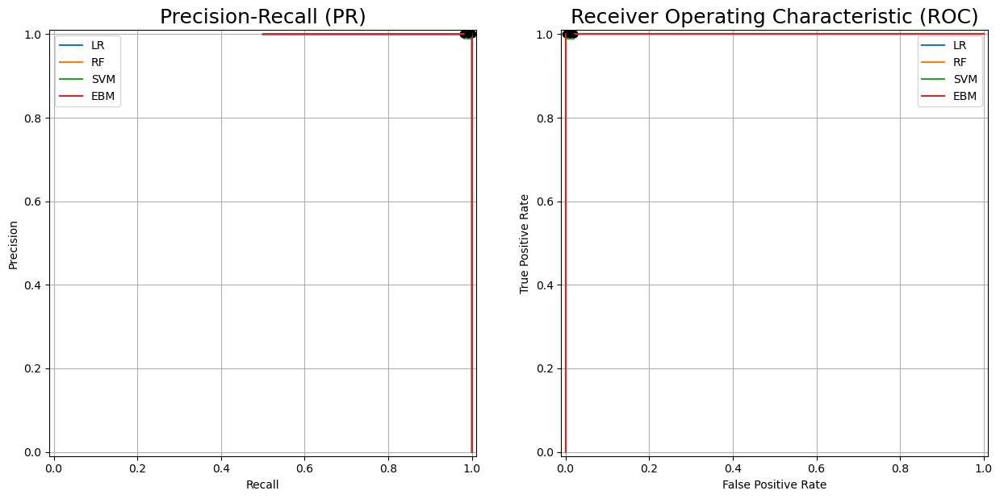

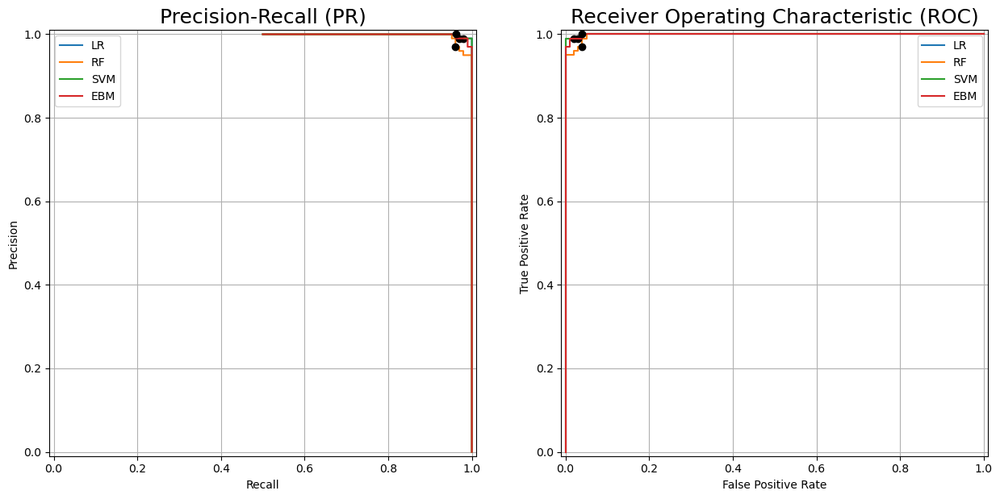

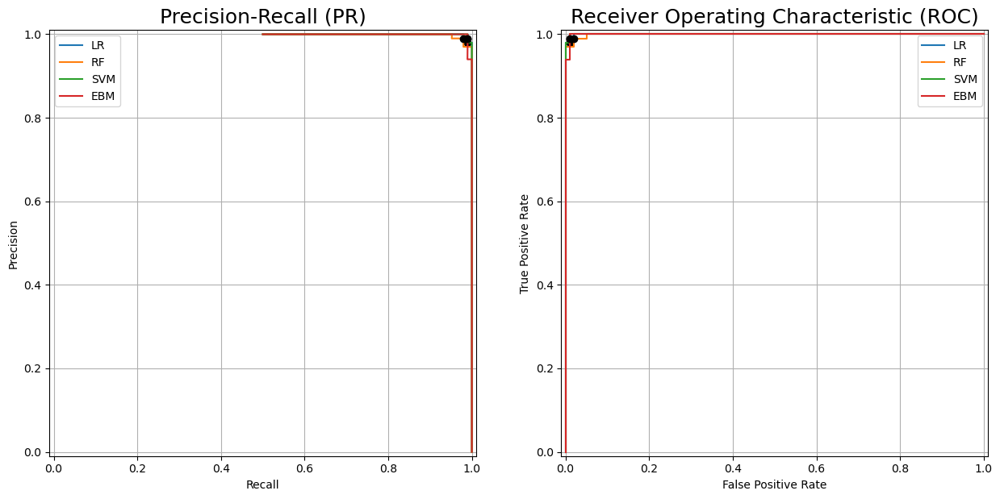

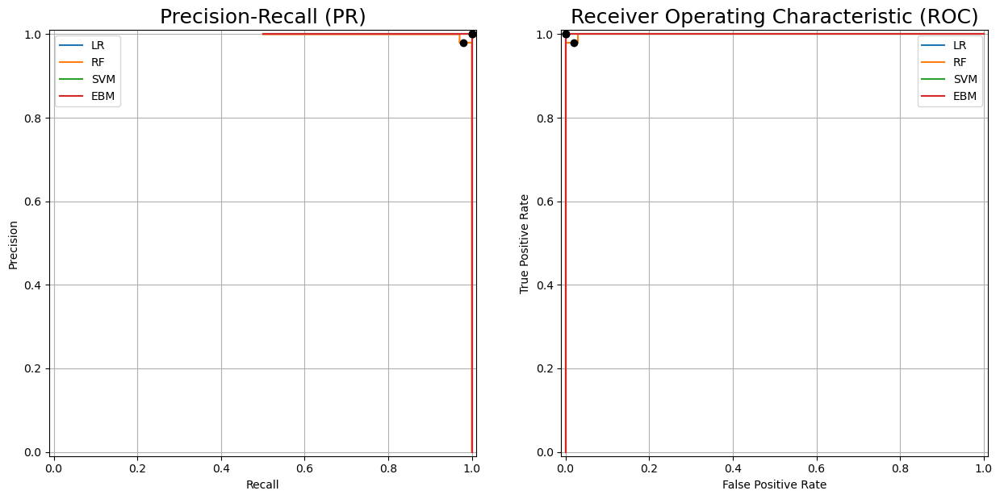

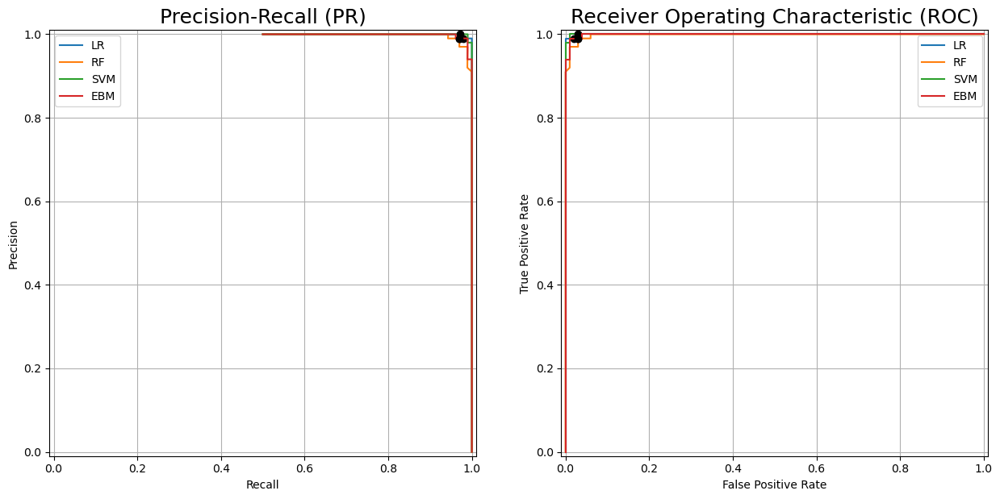

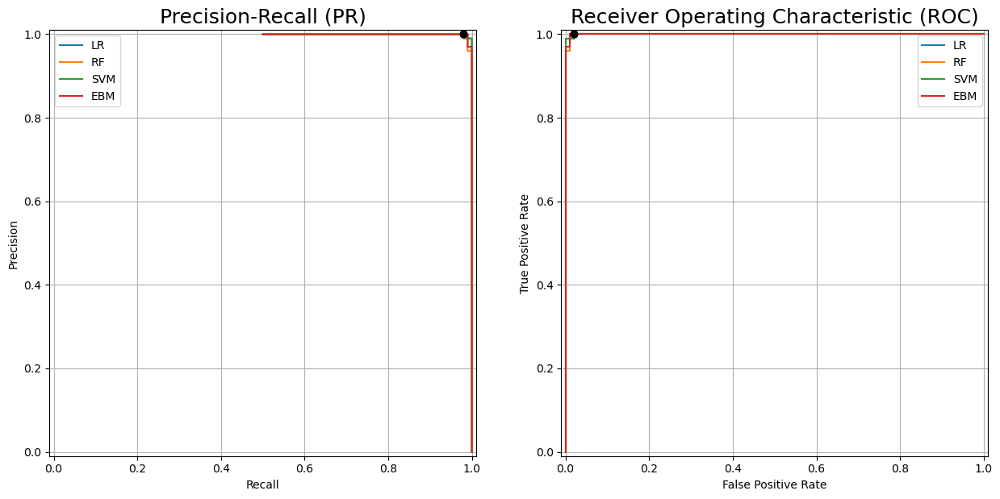

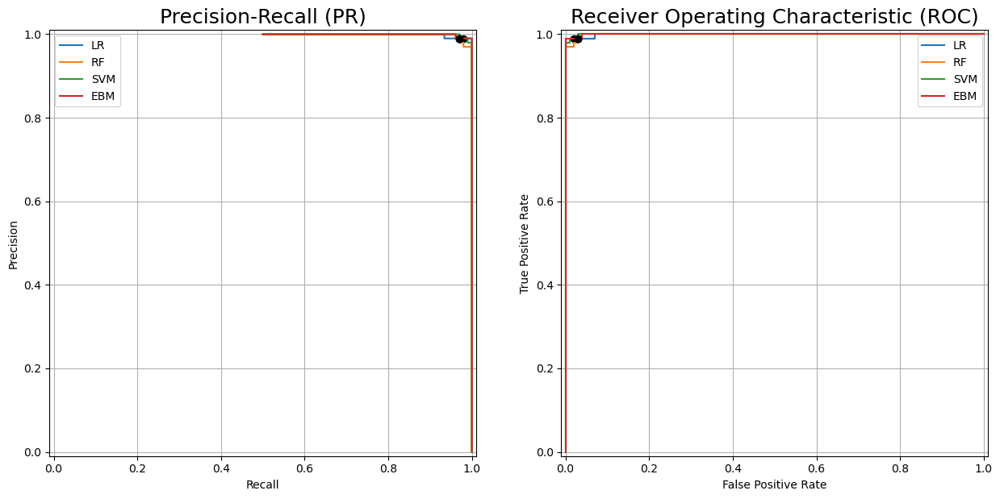

In [782]:
for i in range(sss_nsplits):
    plt.figure(figsize=(15, 10))
    
    lr_ye = lr_clfs[i].predict(X_tests_pd[i].to_numpy())
    rf_ye = rf_clfs[i].predict(X_tests_pd[i].to_numpy())
    svm_ye = svm_clfs[i].predict(X_tests_pd[i].to_numpy())
    ebm_ye = ebm_clfs[i].predict(X_tests_pd[i].to_numpy())
    
    lr_cm = lr_cms[i]
    rf_cm = rf_cms[i]
    svm_cm = svm_cms[i]
    ebm_cm = ebm_cms[i]
    
    lr_y2d = lr_clfs[i].predict_proba(X_tests_pd[i].to_numpy())[:, 1]
    rf_y2d = rf_clfs[i].predict_proba(X_tests_pd[i].to_numpy())[:, 1]
    svm_y2d = svm_clfs[i].decision_function(X_tests_pd[i].to_numpy())
    ebm_y2d = ebm_clfs[i].decision_function(X_tests_pd[i].to_numpy())
    
    plt.subplot(1,2,1)
    perf_analysis.compare_PR([Y_tests[i], Y_tests[i], Y_tests[i], Y_tests[i]], [lr_cm, rf_cm, svm_cm, ebm_cm], [lr_y2d, rf_y2d, svm_y2d, ebm_y2d], ["LR","RF", "SVM", "EBM"])
    
    plt.subplot(1,2,2)
    perf_analysis.compare_ROC([Y_tests[i], Y_tests[i], Y_tests[i], Y_tests[i]], [lr_cm, rf_cm, svm_cm, ebm_cm], [lr_y2d, rf_y2d, svm_y2d, ebm_y2d], ["LR","RF", "SVM", "EBM"])
    
    plt.savefig(f"{logs_dir}/synth_bin_test_PR_ROC_{i}.png", bbox_inches="tight")
    
    plt.show()

## Local Explanations

### LIME

In [783]:
for i in range(sss_nsplits):
    lr_LIME_explanation = lr_limes[i].explain_instance(X_tests_pd[i].to_numpy()[Exp_index], lr_clfs[i].predict_proba)
    lr_LIME_explanation.show_in_notebook(show_table=True)
    lr_LIME_explanation.save_to_file(f"{logs_dir}/synth_bin_LR_LIME_{i}.html")

In [784]:
for i in range(sss_nsplits):
    rf_LIME_explanation = rf_limes[i].explain_instance(X_tests_pd[i].to_numpy()[Exp_index], rf_clfs[i].predict_proba)
    rf_LIME_explanation.show_in_notebook(show_table=True)
    rf_LIME_explanation.save_to_file(f"{logs_dir}/synth_bin_RF_LIME_{i}.html")

In [785]:
for i in range(sss_nsplits):
    svm_LIME_explanation = svm_limes[i].explain_instance(X_tests_pd[i].to_numpy()[Exp_index], svm_clfs[i].predict_proba)
    svm_LIME_explanation.show_in_notebook(show_table=True)
    svm_LIME_explanation.save_to_file(f"{logs_dir}/synth_bin_SVM_LIME_{i}.html")

### SHAP & EBM

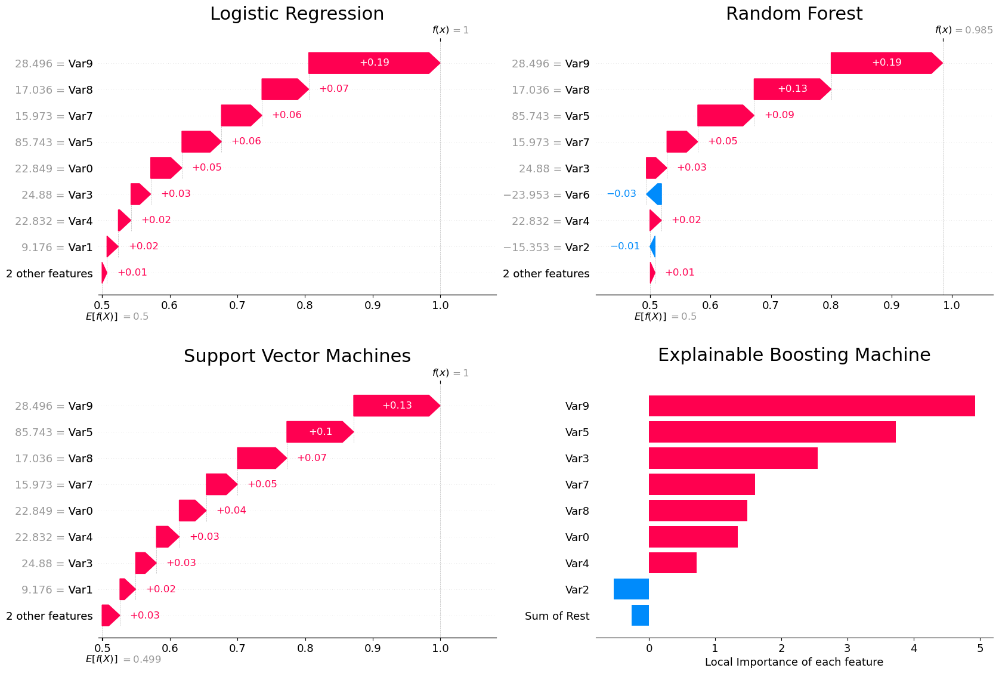

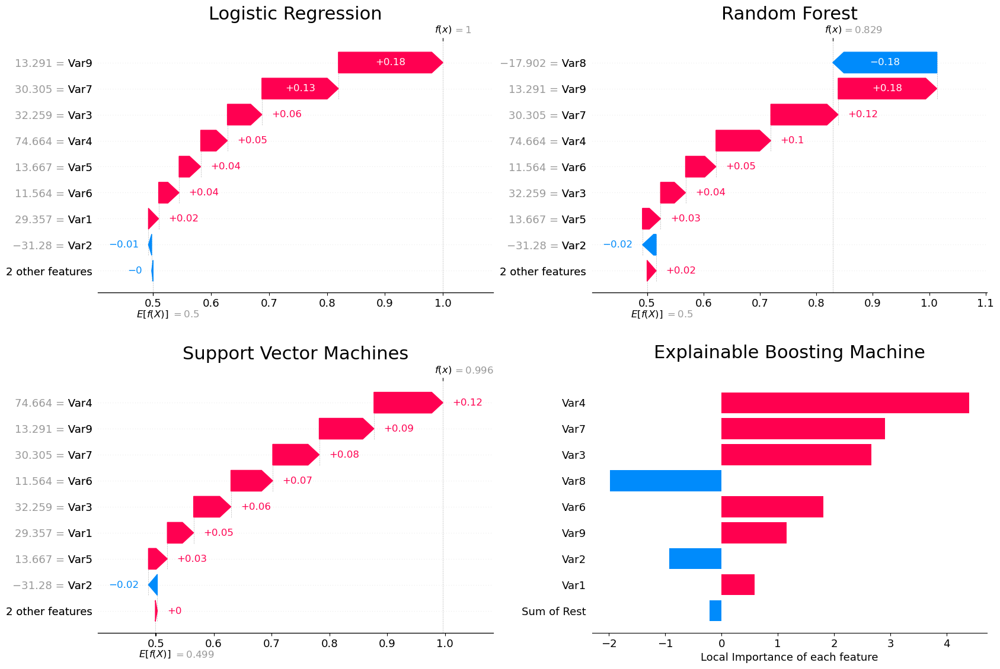

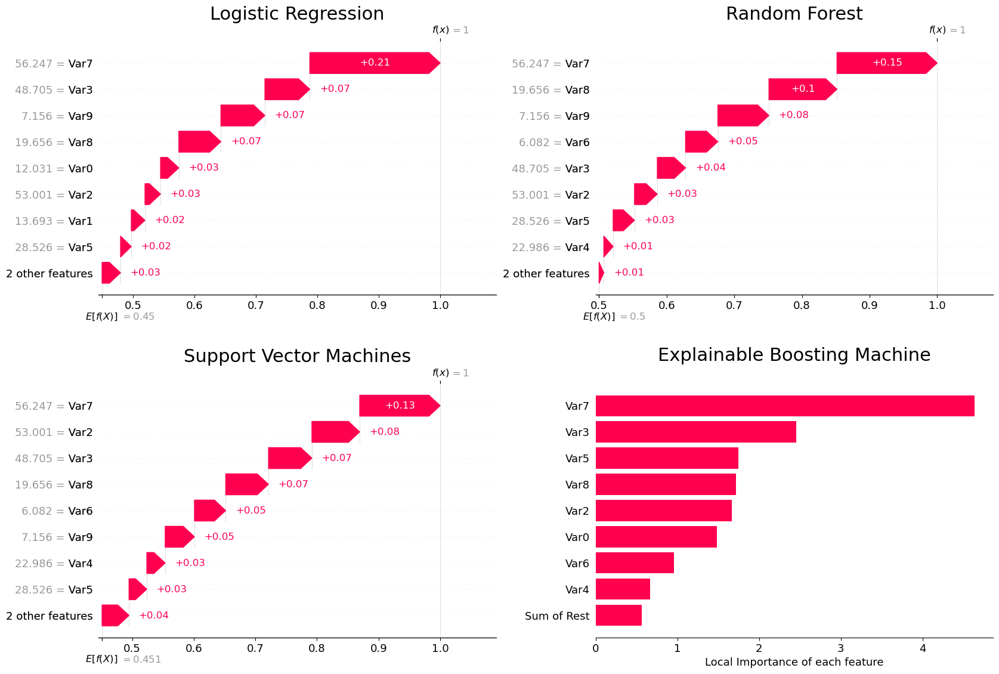

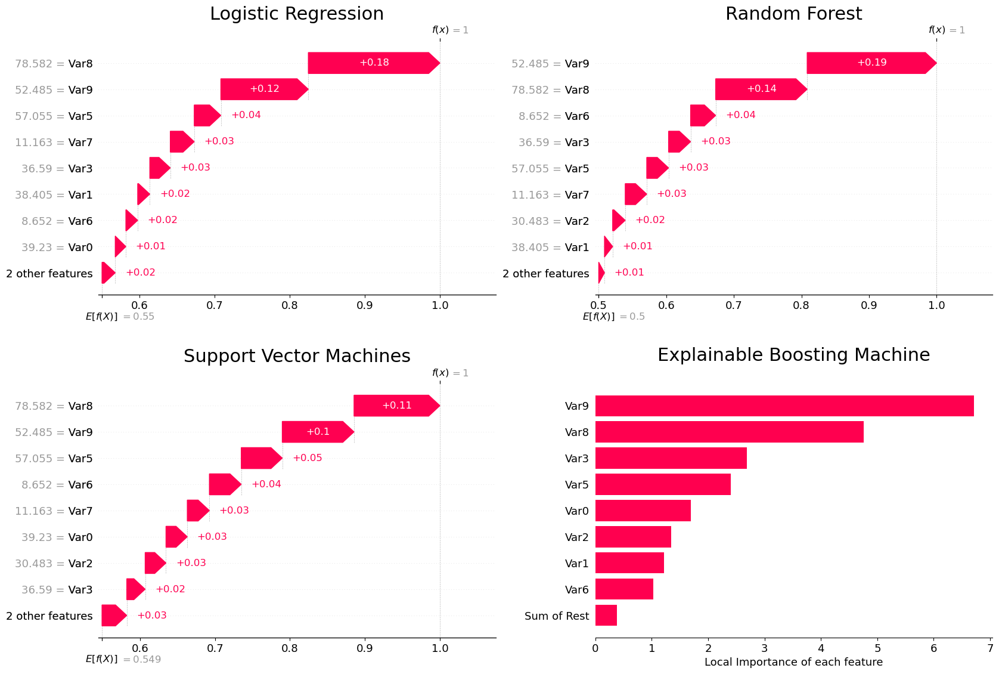

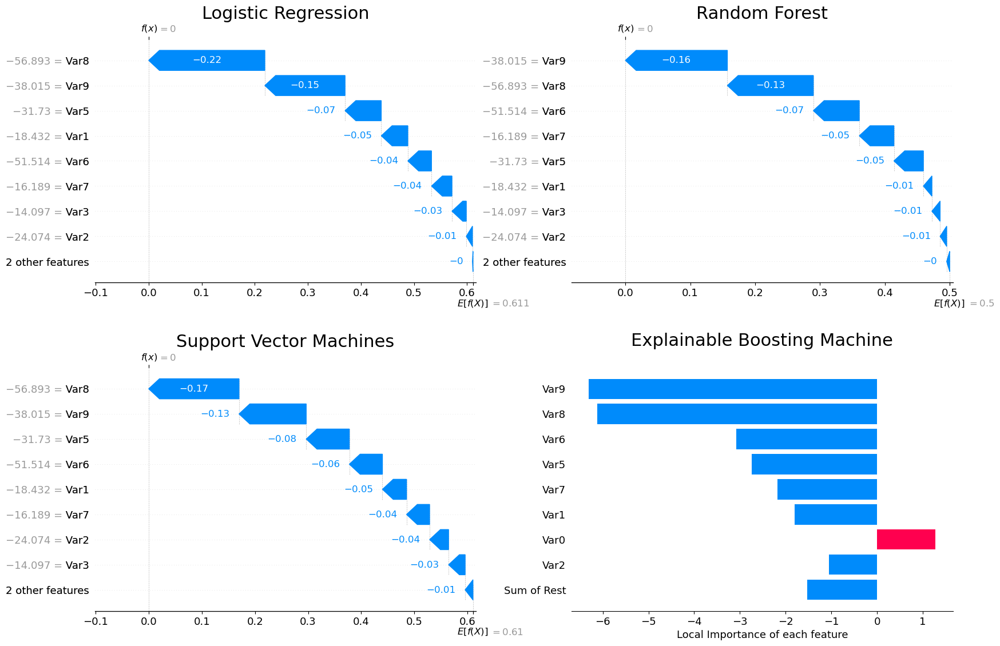

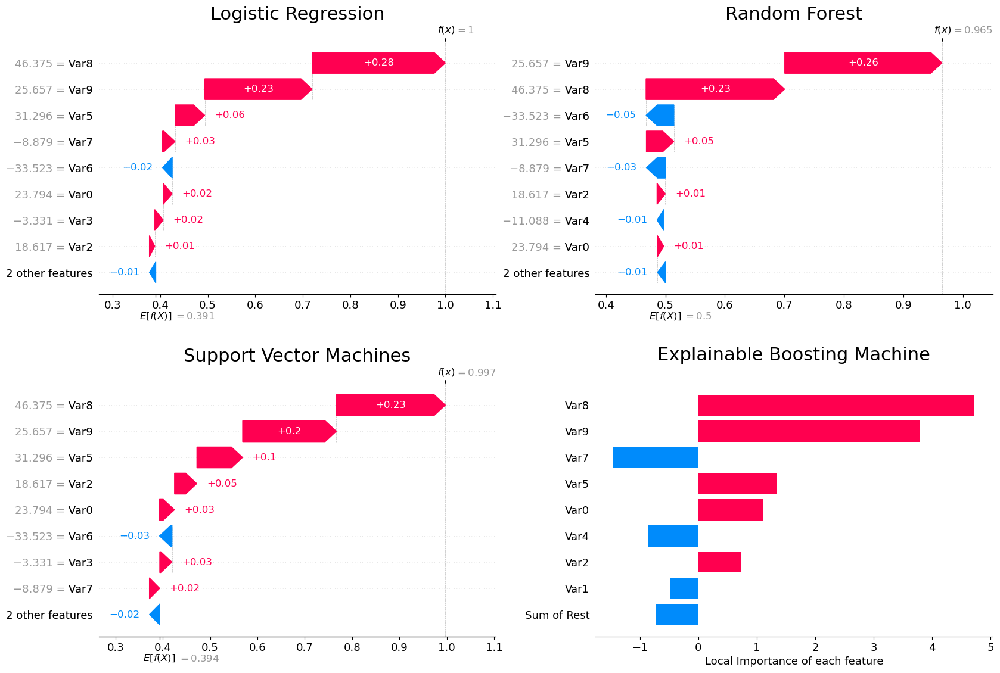

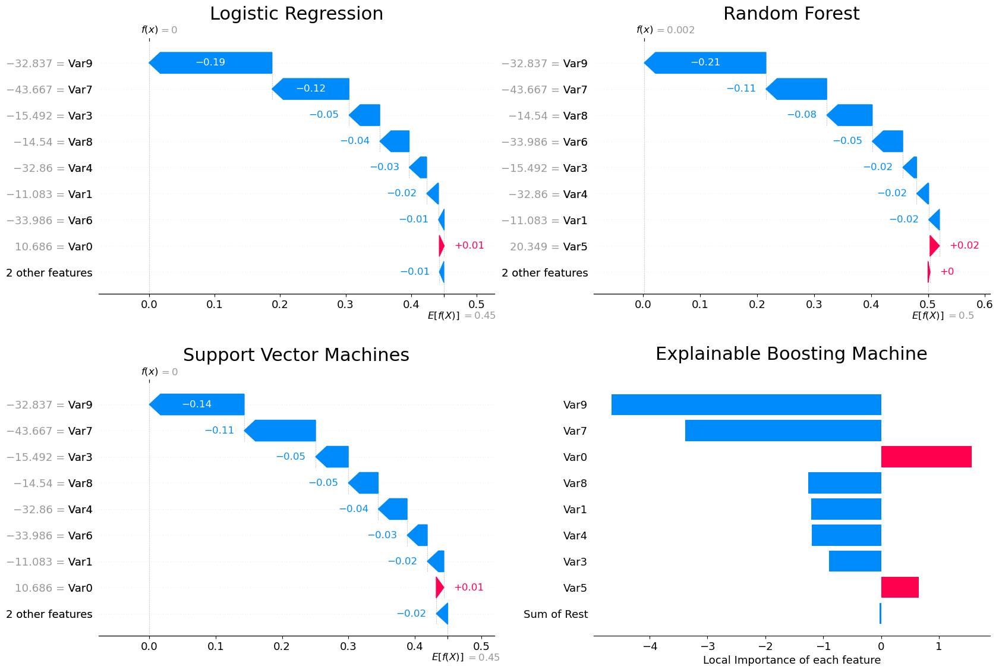

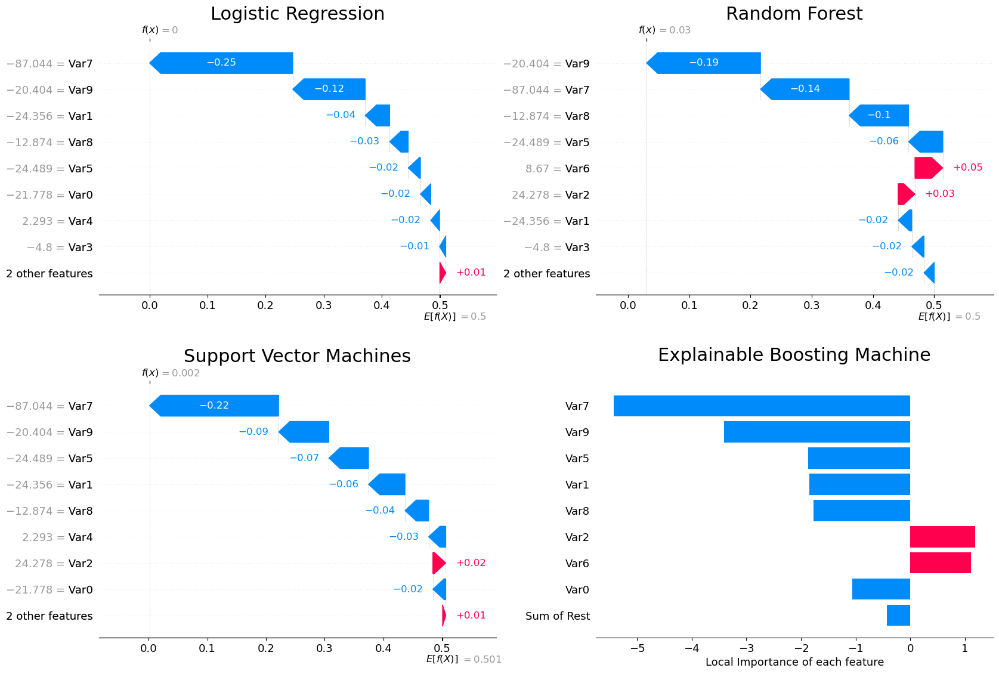

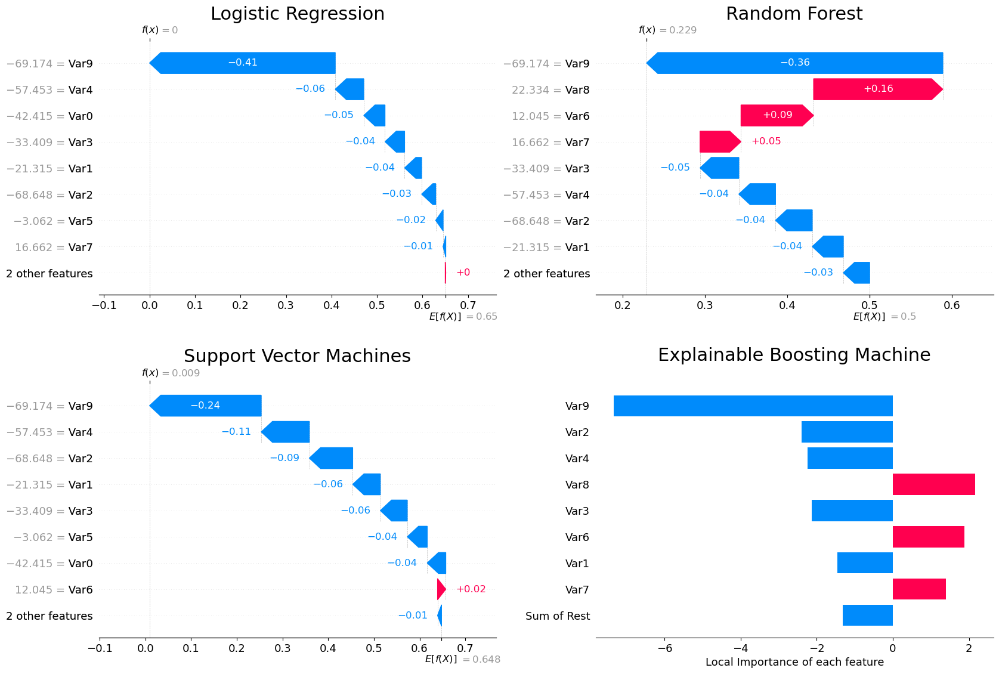

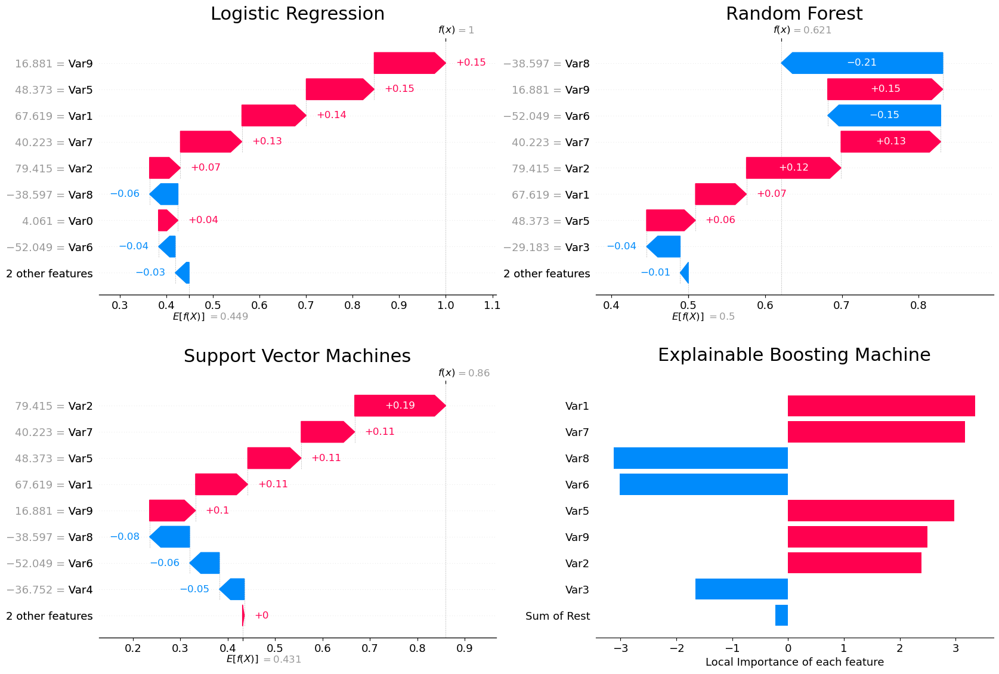

In [786]:
for i in range(sss_nsplits):
    Exp_inst_pd = X_tests_pd[i].iloc[Exp_index]
    
    lr_shap_loc_values = np.array(lr_shaps[i].shap_values(Exp_inst_pd))
    rf_shap_loc_values = np.array(rf_shaps[i].shap_values(Exp_inst_pd))
    svm_shap_loc_values = np.array(svm_shaps[i].shap_values(Exp_inst_pd))
    
    explanations = [shap.Explanation(lr_shap_loc_values[1, :], lr_shaps[i].expected_value[1], data=Exp_inst_pd),
                shap.Explanation(rf_shap_loc_values[1, :], rf_shaps[i].expected_value[1], data=Exp_inst_pd),
                shap.Explanation(svm_shap_loc_values[1, :], svm_shaps[i].expected_value[1], data=Exp_inst_pd)]
    
    ebm_local = ebm_clfs[i].explain_local(X_tests_pd[i], Y_tests[i])
    
    visual.local_shap(explanations, 
                      ebm_local.data(key=Exp_index),
                      nrows = 2,
                      ncols = 2,
                      figsize = (15,10),
                      title_size = 22,
                      label_size = label_size,
                      titles = ["Logistic Regression", "Random Forest", "Support Vector Machines"],
                      ebm_colors = shap_colors / 255,
                      num_features=9)
    
    plt.savefig(f"{logs_dir}/synth_bin_test_local_SHAP_EBM_{i}.png", bbox_inches="tight")
    
    plt.show()


## Global Explanations

  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/200 [00:00<?, ?it/s]

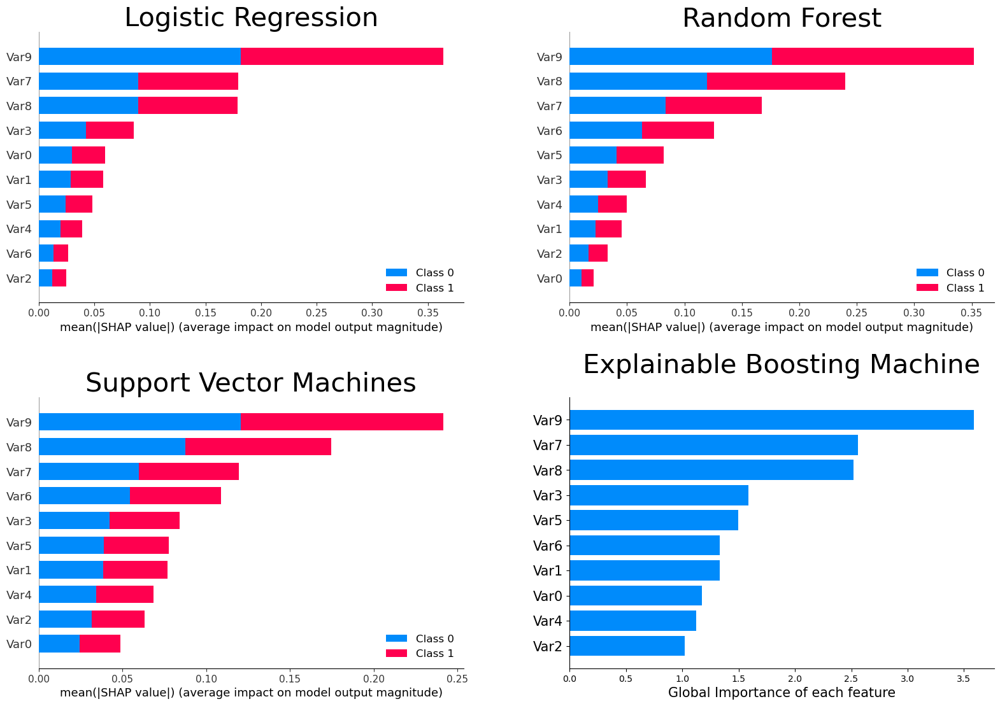

  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/200 [00:00<?, ?it/s]

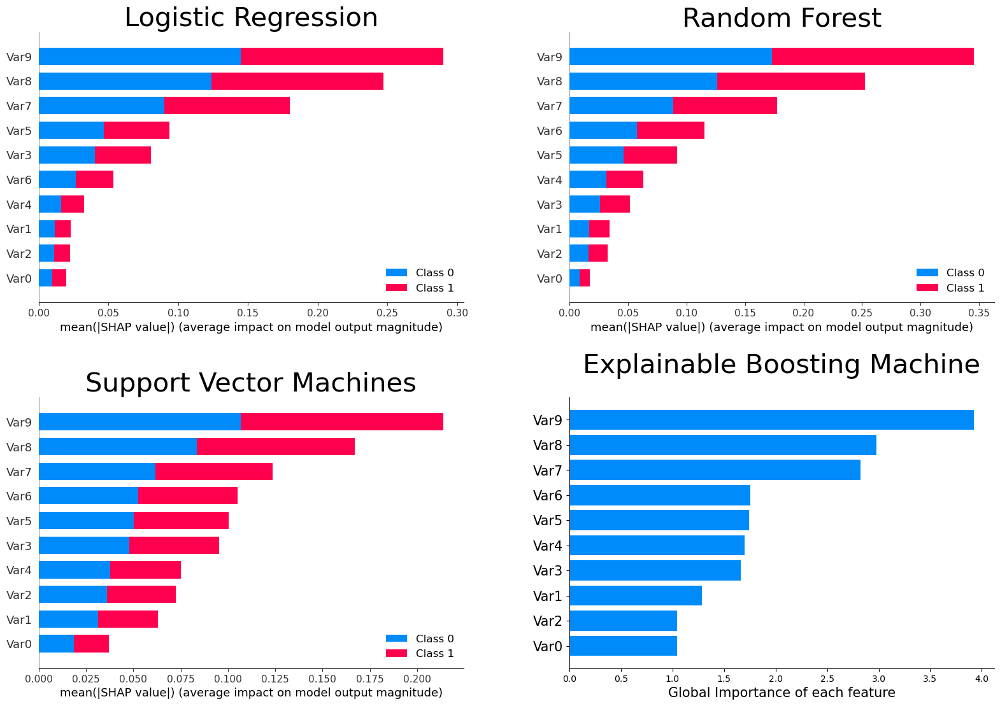

  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/200 [00:00<?, ?it/s]

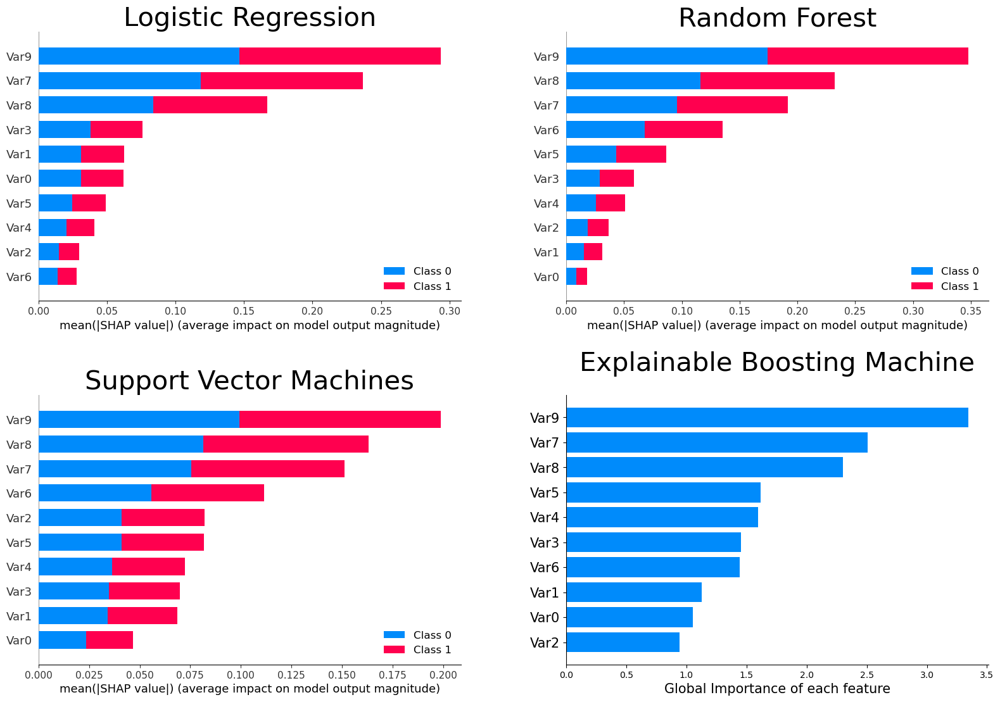

  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/200 [00:00<?, ?it/s]

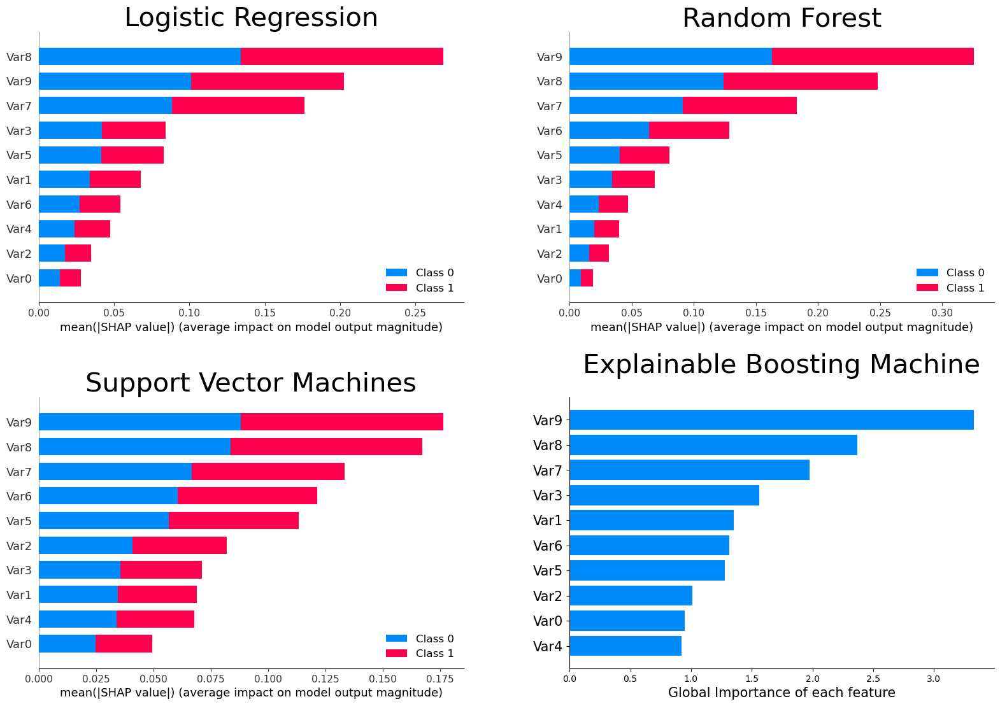

  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/200 [00:00<?, ?it/s]

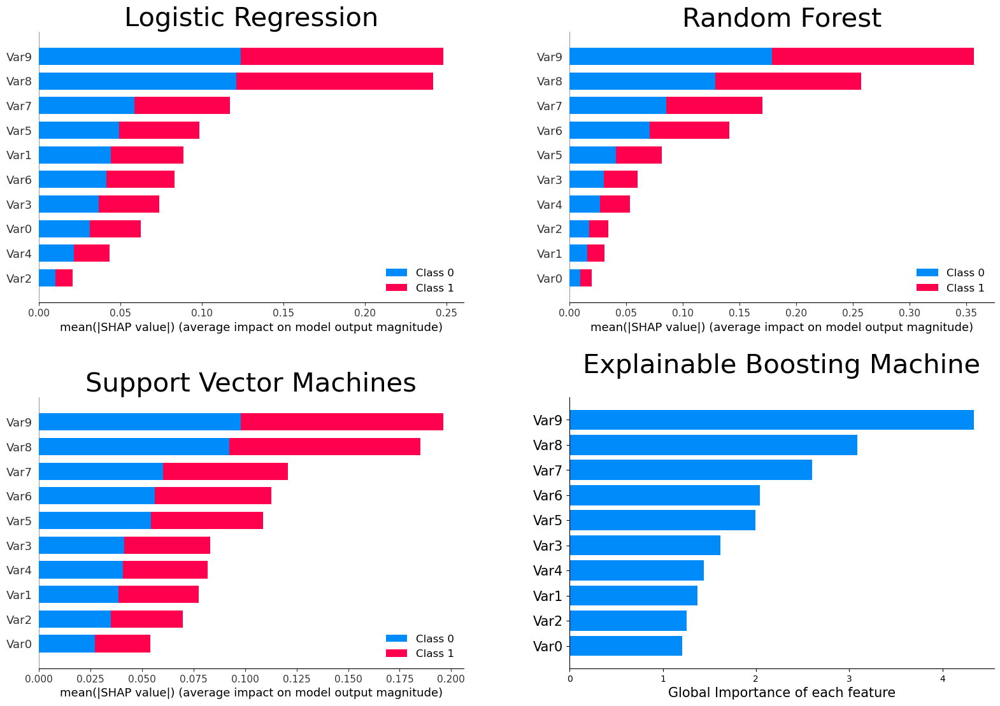

  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/200 [00:00<?, ?it/s]

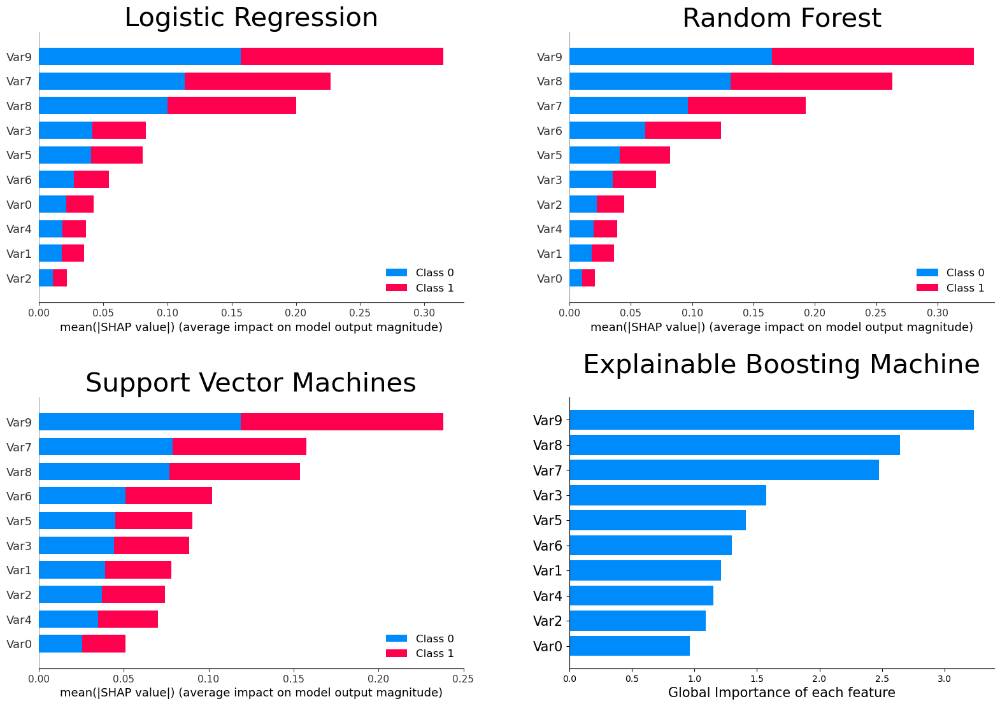

  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/200 [00:00<?, ?it/s]

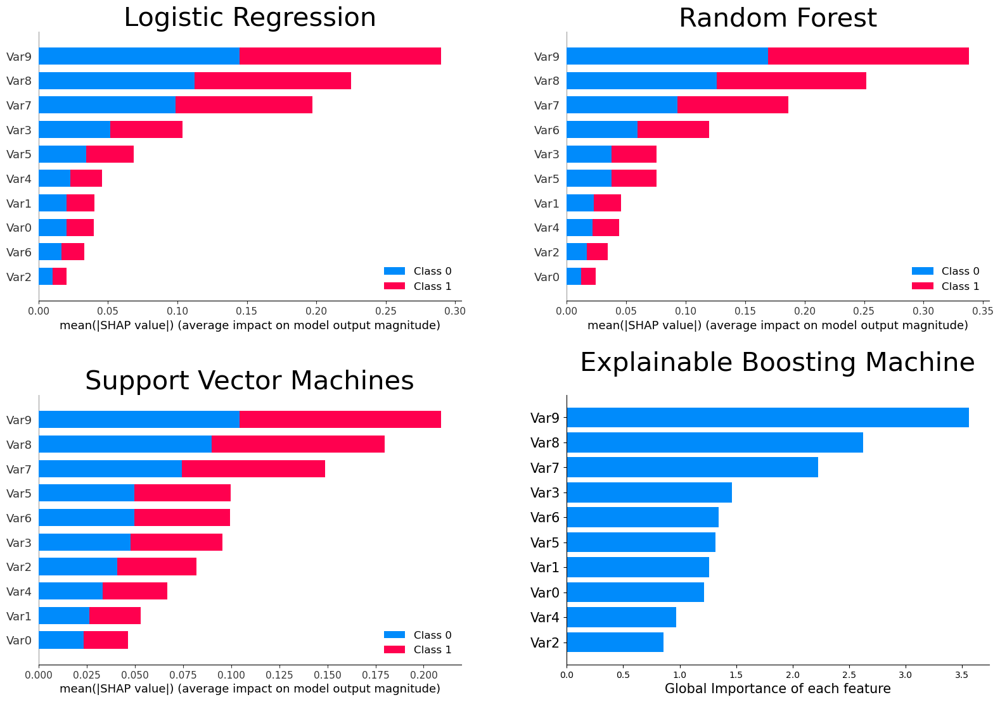

  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/200 [00:00<?, ?it/s]

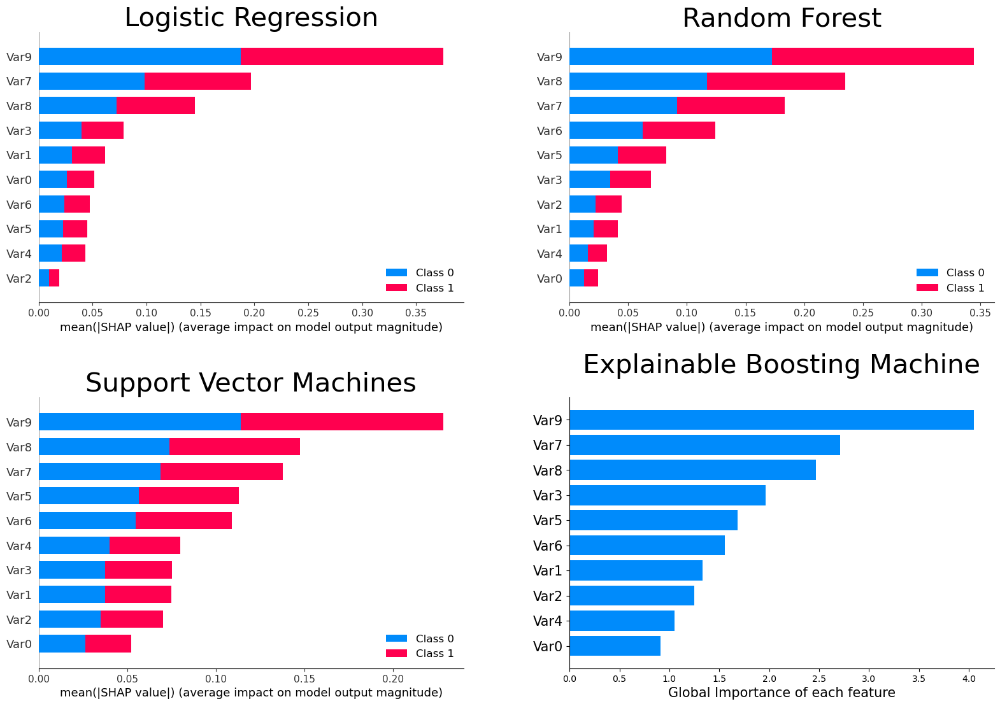

  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/200 [00:00<?, ?it/s]

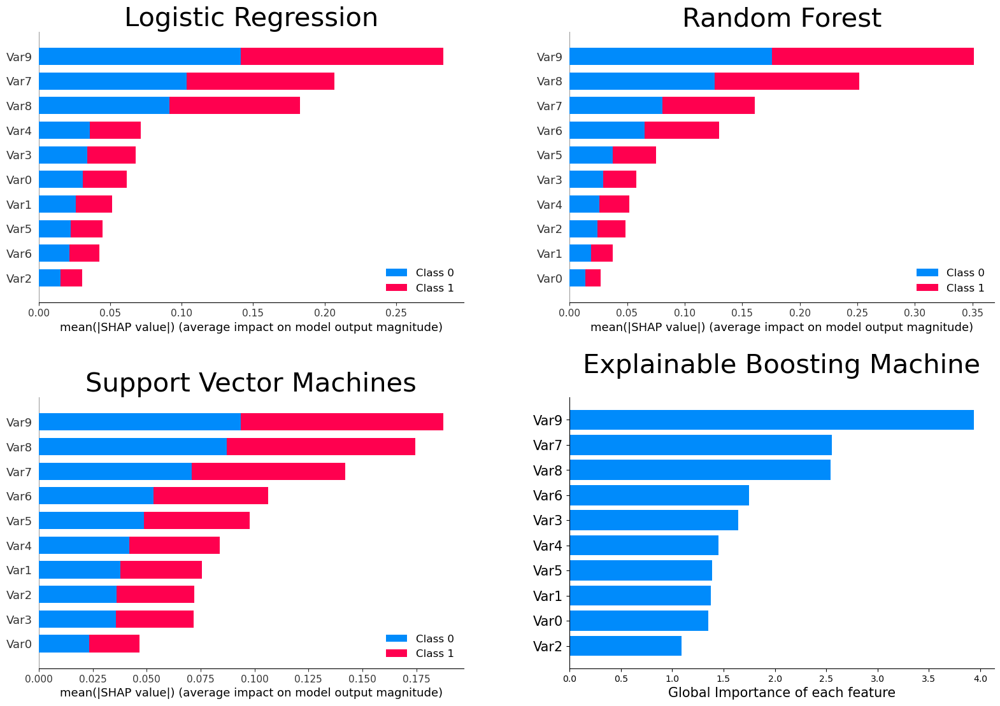

  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/200 [00:00<?, ?it/s]

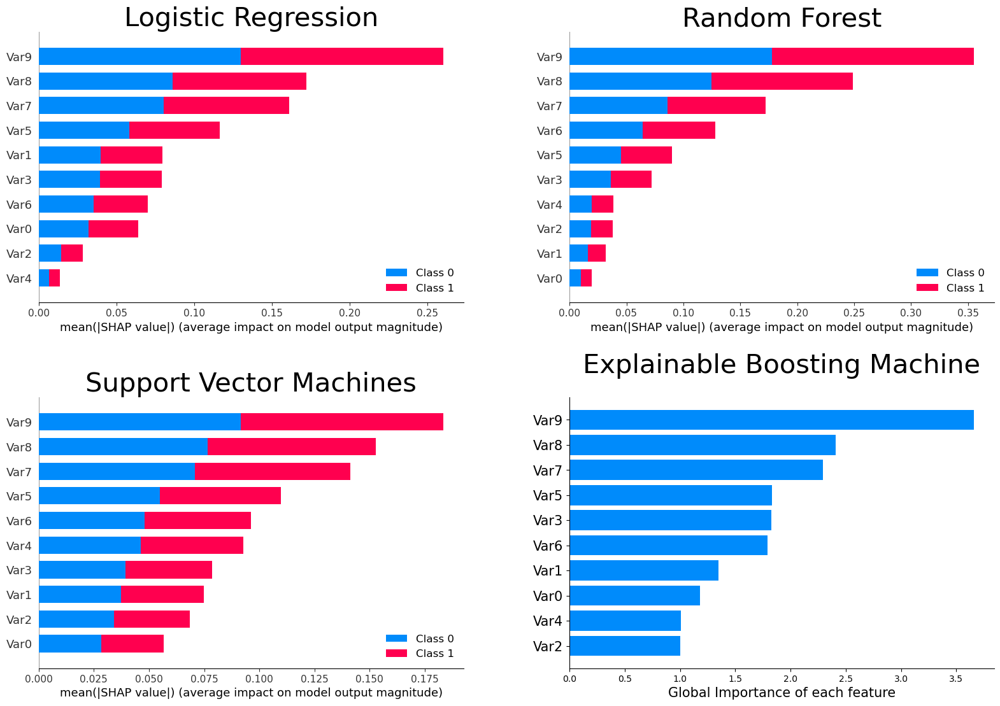

In [787]:
for i in range(sss_nsplits):
    lr_shap_global_values = lr_shaps[i].shap_values(X_tests_pd[i])
    rf_shap_global_values = rf_shaps[i].shap_values(X_tests_pd[i])
    svm_shap_global_values = svm_shaps[i].shap_values(X_tests_pd[i])

    global_shap_values = [lr_shap_global_values,
                      rf_shap_global_values,
                      svm_shap_global_values]

    ebm_global = ebm_clfs[i].explain_global()

    visual.global_shap(global_shap_values,
                       X_tests_pd[i],
                       ebm_global.data(),
                       nrows = 2,
                       ncols = 2,
                       figsize = (15, 10),
                       title_size = 30,
                       label_size = 15,
                       titles = ["Logistic Regression", "Random Forest", "Support Vector Machines"],
                       ebm_colors = shap_colors/255,
                       num_features=20)

    plt.savefig(f"{logs_dir}/synth_bin_test_global_SHAP_EBM{i}.png", bbox_inches="tight")

    plt.show()